# Conditional Self-Attention GAN for Facial Emoji Generation

Adapted from:
- [Build Basic Generative Adversarial Networks (GANs) Week 4 Programming Assignment](https://www.coursera.org/learn/build-basic-generative-adversarial-networks-gans/programming/aFndv/conditional-gan)
- [Self-Attention GAN](https://github.com/heykeetae/Self-Attention-GAN)

### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from cgan.model import *
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(3, 64, 64), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

### Noise

In [2]:
def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

### Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. 


In [3]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    return F.one_hot(labels, num_classes=n_classes)

Next, we need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. We will also need to do this when adding the class channels to the discriminator.

In [4]:
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    combined = torch.cat((x.float(), y.float()), dim=1)
    return combined

### Parameters

*   image_shape: the number of pixels in each image. We further downsize every image to 64 x 64 to be compatible with the self-attention GAN architecture
*   n_classes: the number of classes (10, since there are 10 different emojis)
*   image_path: path to image folder
*   criterion: the loss function
*   n_epochs: the number of times to iterate through the entire dataset when training
*   z_dim: the dimension of the noise vector
*   display_step: how often to display/visualize the images
*   batch_size: the number of images per forward/backward pass
*   lr: the learning rate
*   device: the device type
*   g_conv_dim: the number of dimensions in the last convolutional layer of the generator
*   d_conv_dim: the number of dimensions in the first convolutional layer of the discriminator

In [10]:
image_shape = (3, 64, 64)
n_classes = 10
image_path = 'resized_emoji_challenge_128_faces'
criterion = nn.BCEWithLogitsLoss()
n_epochs = 100
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
g_conv_dim = 64
d_conv_dim = 64

if torch.cuda.is_available():
    device = 'cuda'
else:
    device = 'cpu'

In [6]:
transform = transforms.Compose([
    transforms.Resize((image_shape[1], image_shape[2])),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataset = ImageFolder(image_path, transform=transform)

dataloader = DataLoader(
    dataset,
    batch_size=batch_size,
    shuffle=True)

Then, we can initialize our generator, discriminator, and optimizers. To do this, we will need to update the input dimensions for both models. For the generator, we will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, we need to add a channel for every class.

In [7]:
def get_input_dimensions(z_dim, image_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        image_shape: the shape of each image as (C, W, H)
        n_classes: the total number of classes in the dataset, an integer scalar
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
    '''
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = image_shape[0] + n_classes
    return generator_input_dim, discriminator_im_chan

In [8]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, image_shape, n_classes)

gen = Generator(image_shape[1], generator_input_dim, g_conv_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(discriminator_im_chan, d_conv_dim).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        try:
            torch.nn.init.normal_(m.weight, 0.0, 0.02)
        except:
            pass
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

### Training

  0%|          | 0/1189 [00:00<?, ?it/s]

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!
Step 500: Generator loss: 6.949762758255005, discriminator loss: 0.022838457021811337


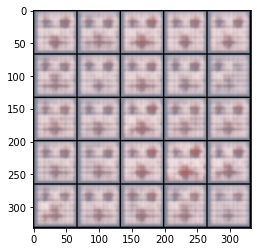

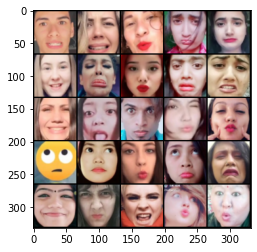

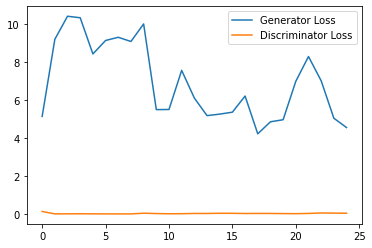

Step 1000: Generator loss: 3.870887085437775, discriminator loss: 0.11635317658213898


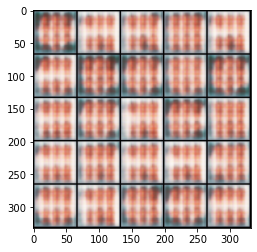

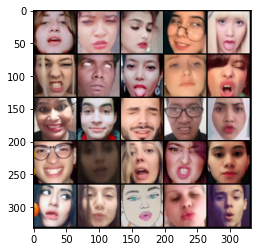

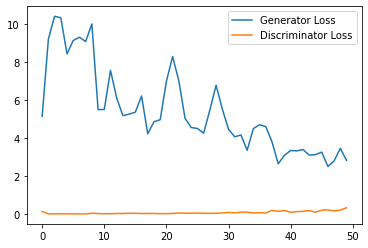

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 1500: Generator loss: 2.906550570011139, discriminator loss: 0.2371688311509788


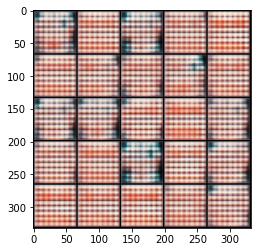

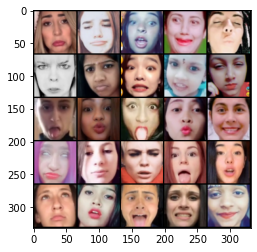

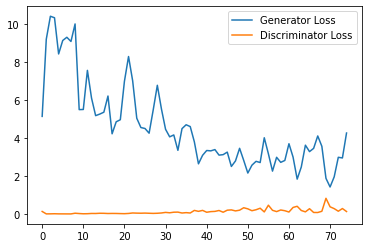

Step 2000: Generator loss: 2.4408895900249483, discriminator loss: 0.3503676040507853


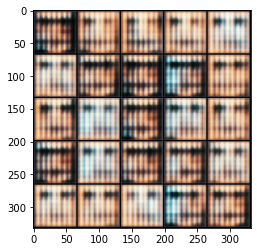

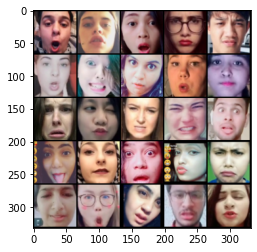

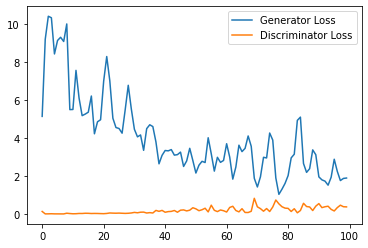

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 2500: Generator loss: 2.980798046350479, discriminator loss: 0.30173917657136917


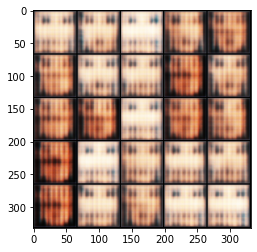

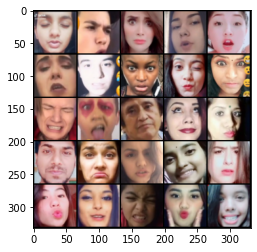

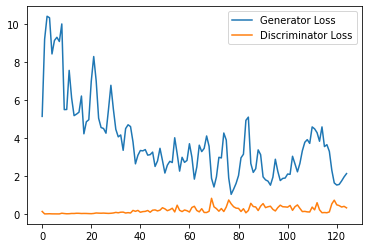

Step 3000: Generator loss: 1.9676852052211762, discriminator loss: 0.40226487515866755


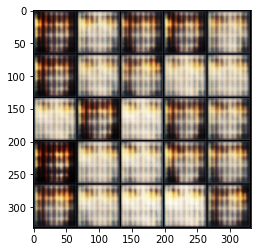

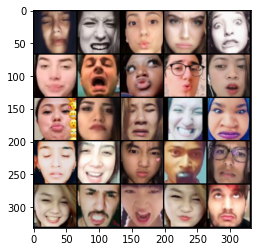

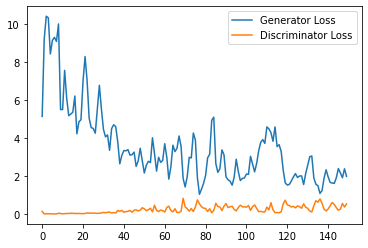

Step 3500: Generator loss: 1.9485147924423218, discriminator loss: 0.41340854643285274


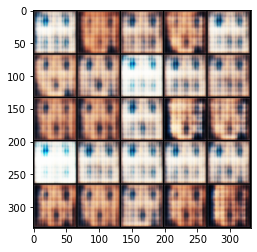

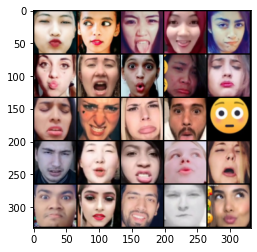

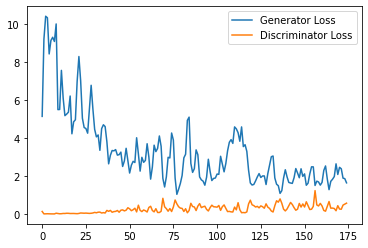

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 4000: Generator loss: 1.7824878686666488, discriminator loss: 0.41339468932151796


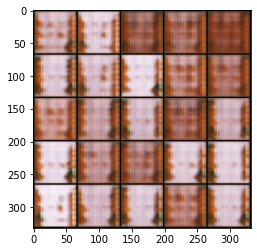

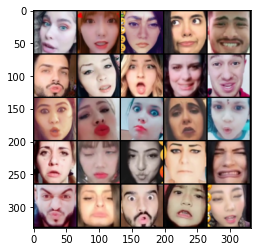

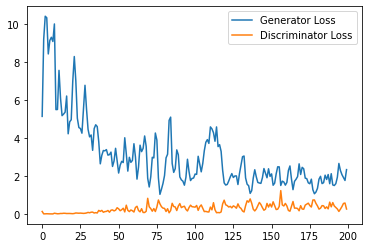

Step 4500: Generator loss: 2.0213364721536635, discriminator loss: 0.3990515859872103


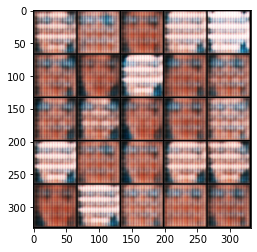

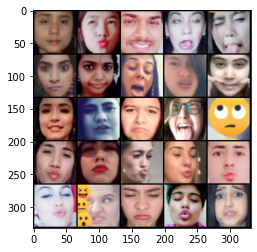

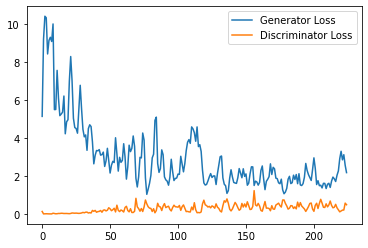

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 5000: Generator loss: 2.730392574548721, discriminator loss: 0.3540579351186752


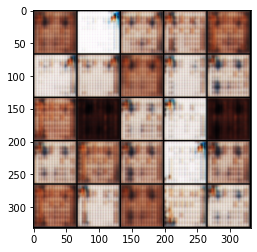

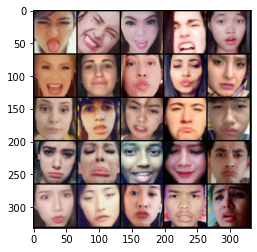

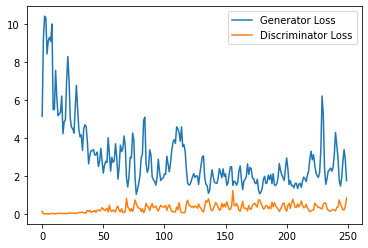

Step 5500: Generator loss: 2.1523035434484483, discriminator loss: 0.36793590399622916


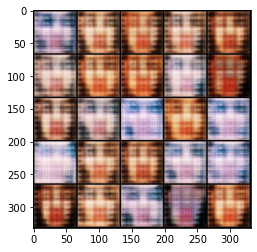

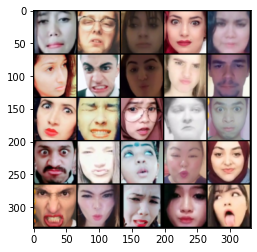

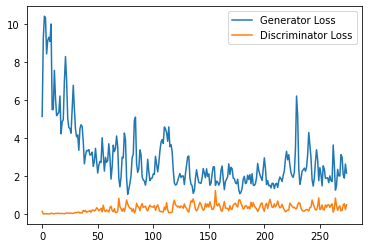

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 6000: Generator loss: 2.158189453601837, discriminator loss: 0.38515107372403146


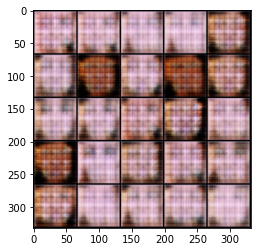

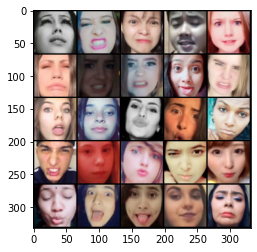

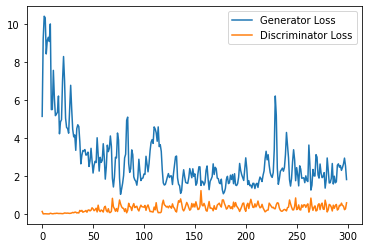

Step 7000: Generator loss: 1.9925618605613709, discriminator loss: 0.36849737623333934


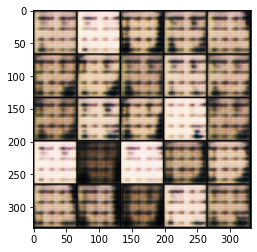

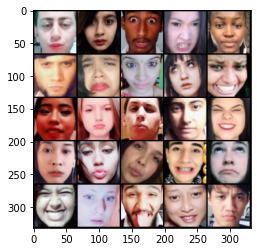

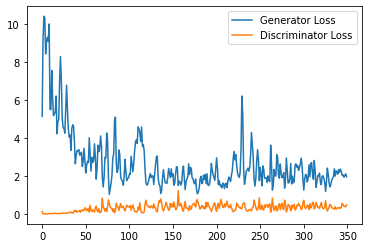

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 7500: Generator loss: 2.1843140325546266, discriminator loss: 0.3231158319711685


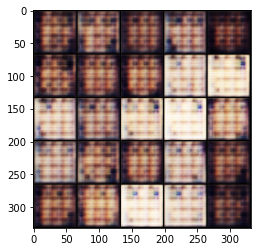

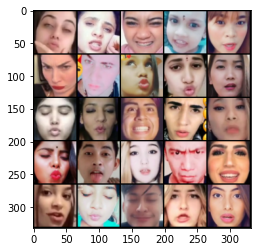

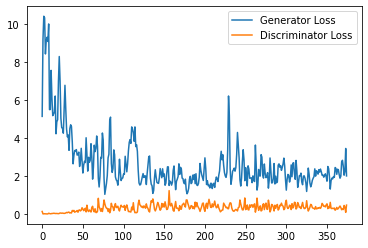

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/1189 [00:00<?, ?it/s]

Step 12000: Generator loss: 2.4741668412685396, discriminator loss: 0.2787804083675146


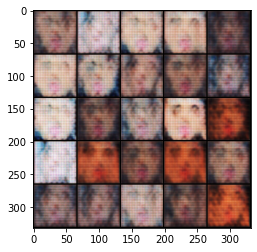

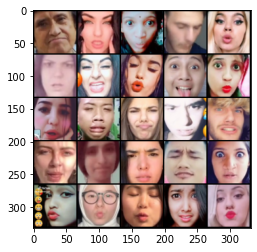

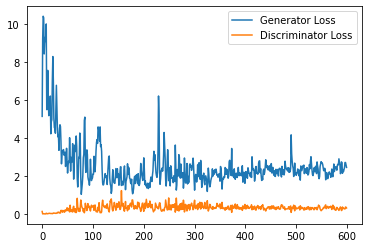

Step 12500: Generator loss: 2.6285446660518645, discriminator loss: 0.25853136867284776


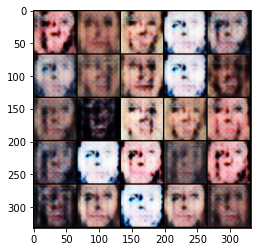

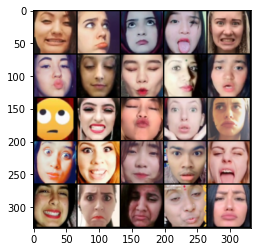

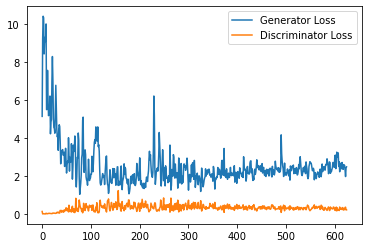

Step 13000: Generator loss: 2.21335276556015, discriminator loss: 0.2953105357289314


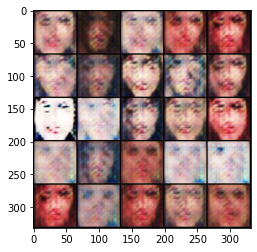

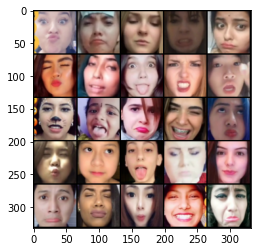

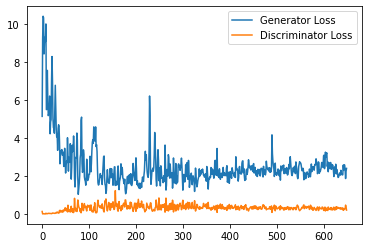

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Step 17000: Generator loss: 2.846847779273987, discriminator loss: 0.2072645274400711


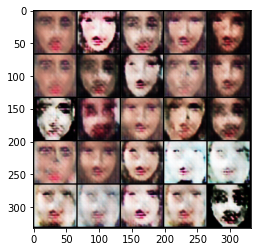

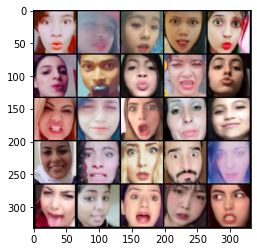

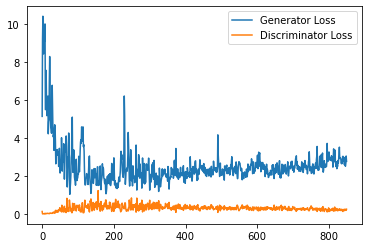

Step 17500: Generator loss: 3.0241664714813234, discriminator loss: 0.1888121209293604


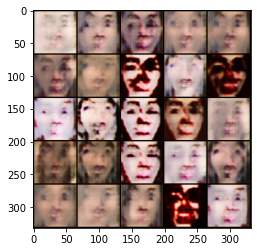

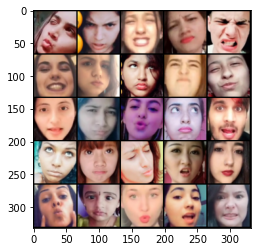

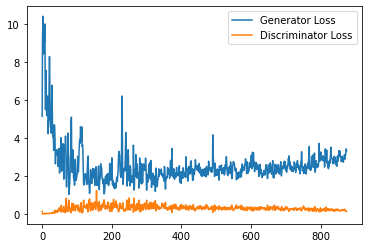

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 18000: Generator loss: 2.9293008880615234, discriminator loss: 0.20604828804731368


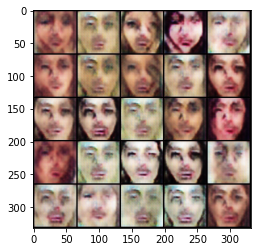

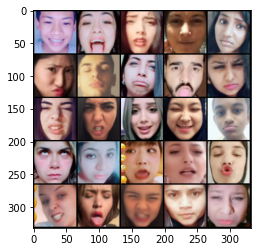

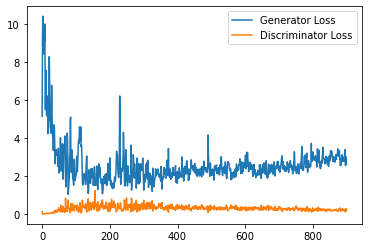

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Step 21000: Generator loss: 2.8652154059410093, discriminator loss: 0.21019354110956193


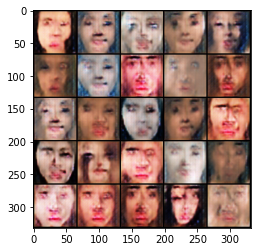

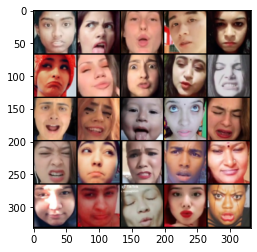

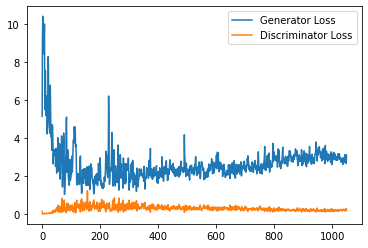

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 21500: Generator loss: 3.0719795060157775, discriminator loss: 0.1842207842171192


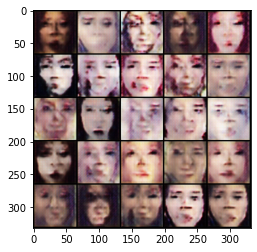

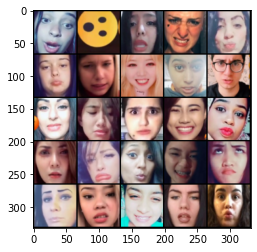

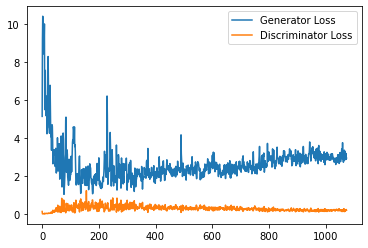

Step 22000: Generator loss: 3.0070454356670377, discriminator loss: 0.2064863659143448


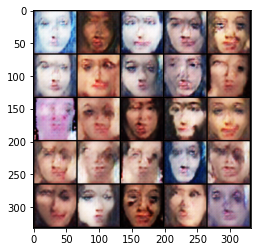

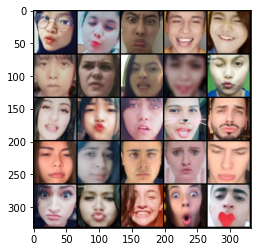

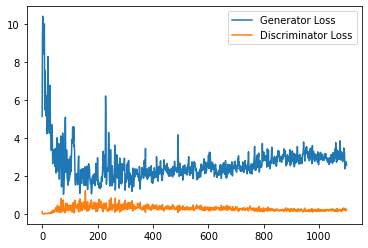

Step 22500: Generator loss: 2.8933456149101255, discriminator loss: 0.20886892907321453


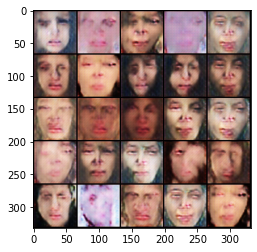

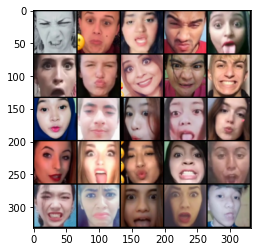

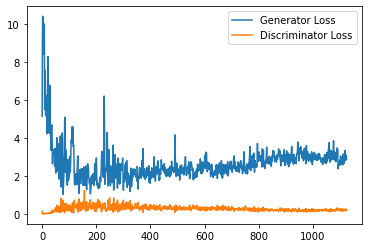

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 23000: Generator loss: 2.7527089104652407, discriminator loss: 0.21288978929817676


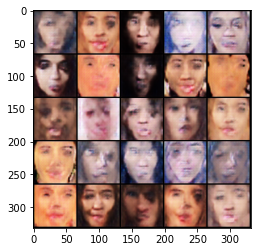

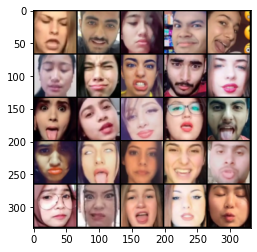

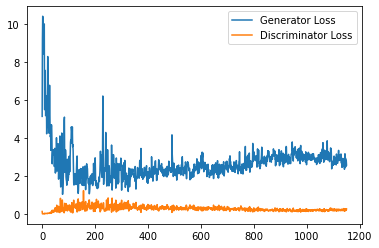

Step 23500: Generator loss: 2.7475621416568754, discriminator loss: 0.23264226545393468


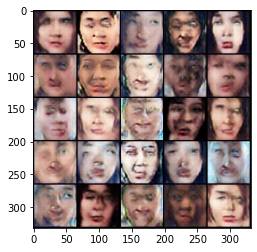

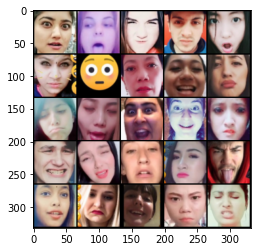

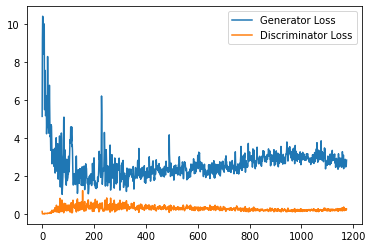

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 24000: Generator loss: 2.6851931576728822, discriminator loss: 0.23527222087979316


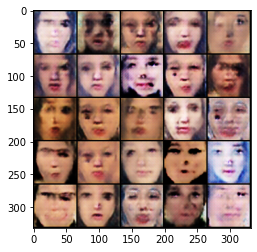

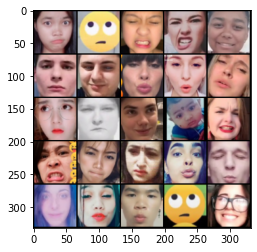

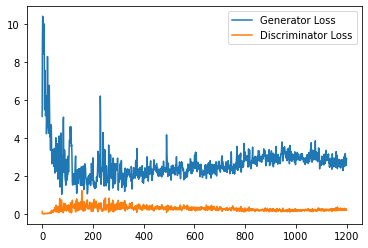

Step 24500: Generator loss: 2.578195159435272, discriminator loss: 0.2547382409721613


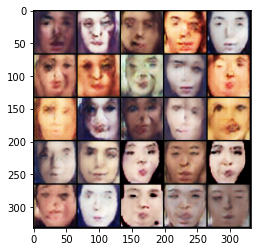

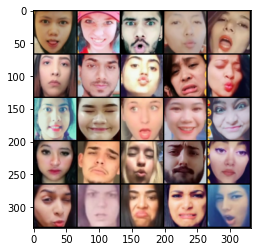

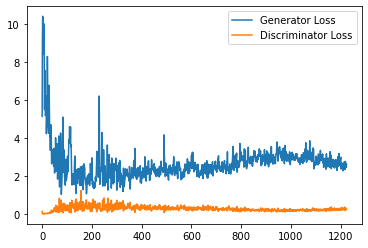

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 25000: Generator loss: 2.656688967704773, discriminator loss: 0.24124933451414107


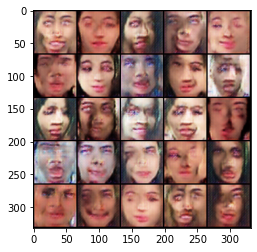

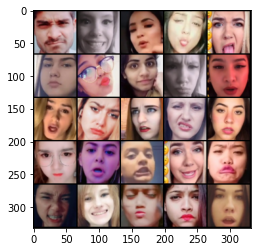

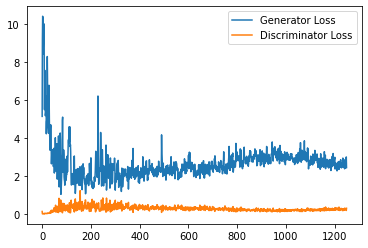

Step 25500: Generator loss: 2.6161633410453797, discriminator loss: 0.24901343968510628


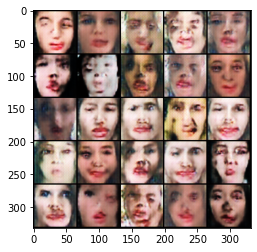

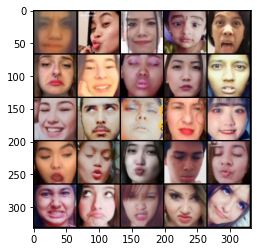

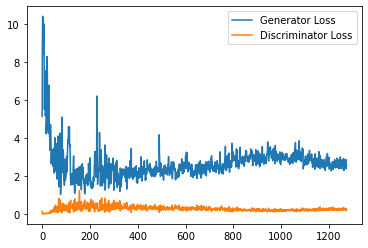

Step 26000: Generator loss: 2.6168357644081115, discriminator loss: 0.24075838693976404


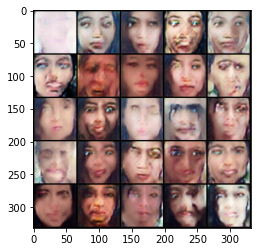

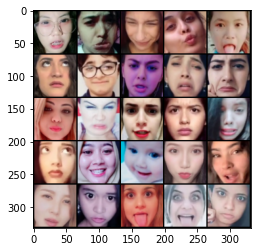

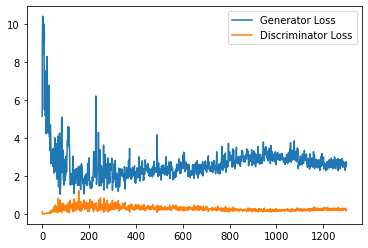

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 26500: Generator loss: 2.484177128791809, discriminator loss: 0.2583297562599182


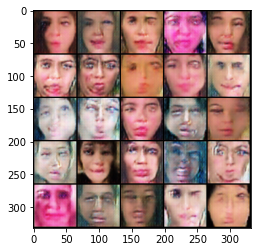

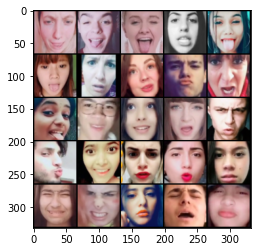

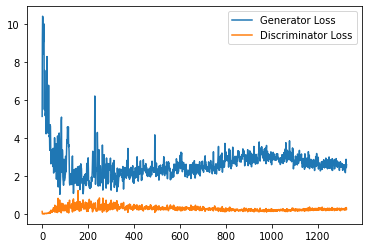

Step 27000: Generator loss: 2.505133483171463, discriminator loss: 0.2801562855541706


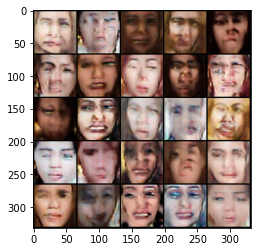

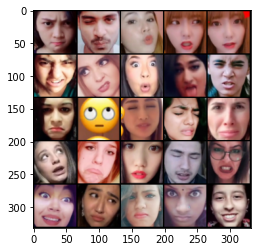

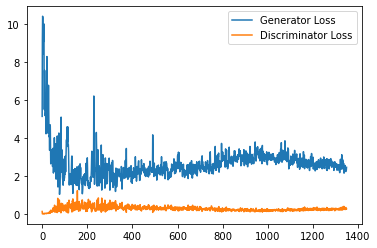

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 27500: Generator loss: 2.4026990649700166, discriminator loss: 0.2790291772186756


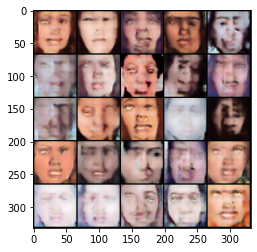

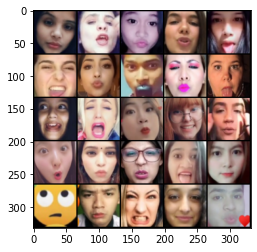

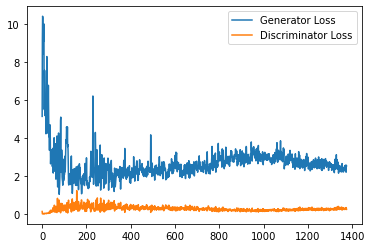

Step 28000: Generator loss: 2.3984716396331787, discriminator loss: 0.28573979350924494


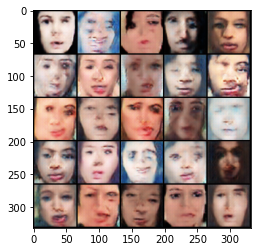

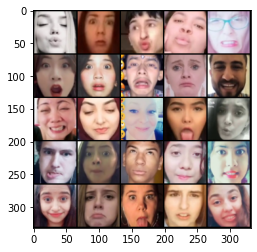

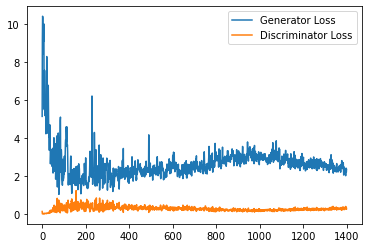

Step 28500: Generator loss: 2.394702986240387, discriminator loss: 0.283413779258728


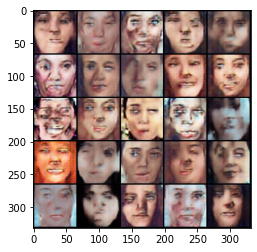

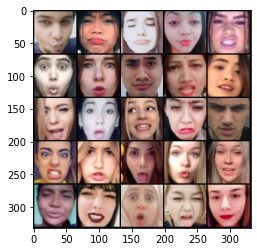

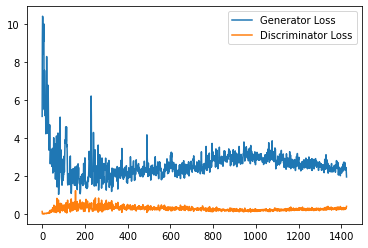

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 29000: Generator loss: 2.4969089274406433, discriminator loss: 0.2683789709210396


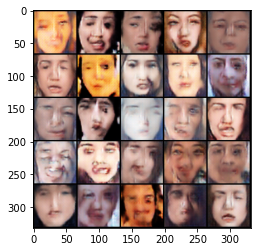

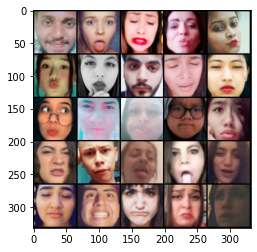

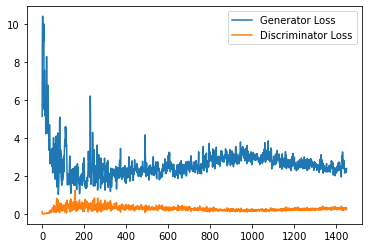

Step 29500: Generator loss: 2.329143622159958, discriminator loss: 0.2885747727751732


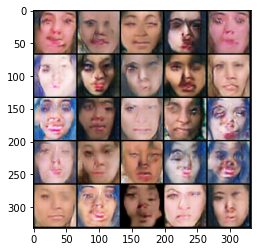

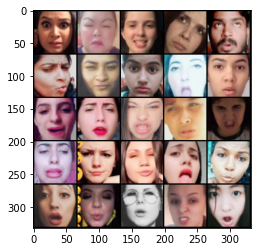

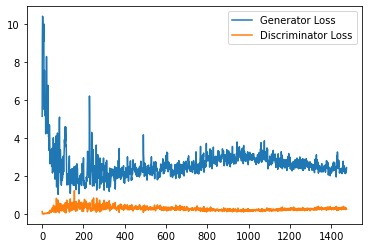

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 30000: Generator loss: 2.395786330461502, discriminator loss: 0.2849292040467262


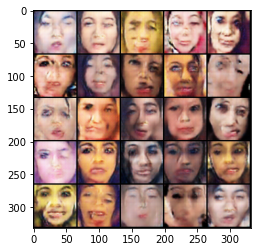

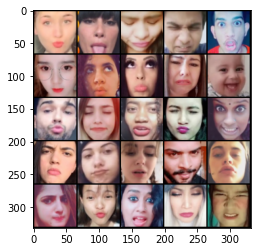

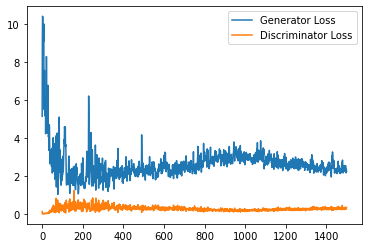

Step 30500: Generator loss: 2.3288789467811584, discriminator loss: 0.30214166724681857


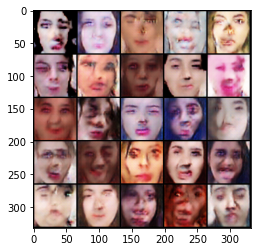

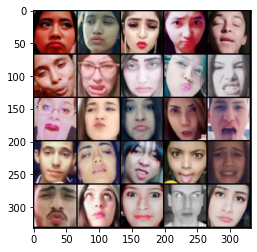

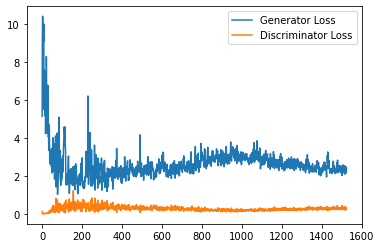

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 31000: Generator loss: 2.362729346036911, discriminator loss: 0.2813502933382988


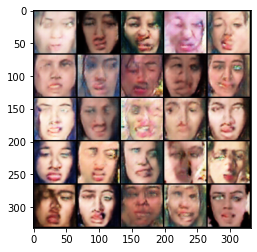

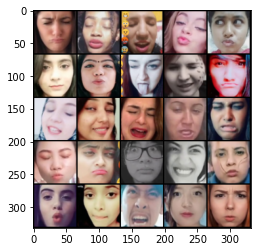

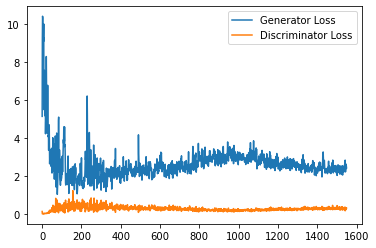

Step 31500: Generator loss: 2.3170458052158356, discriminator loss: 0.3021630158722401


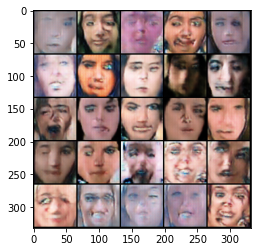

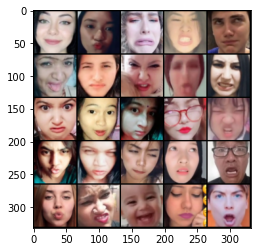

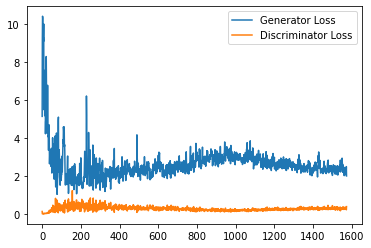

Step 32000: Generator loss: 2.339416843175888, discriminator loss: 0.2901344483494759


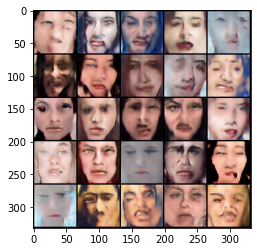

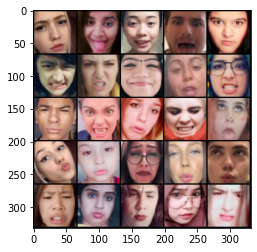

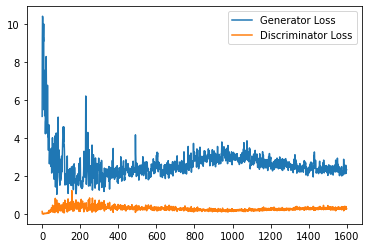

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 32500: Generator loss: 2.3771993255615236, discriminator loss: 0.283798701018095


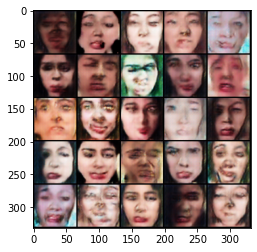

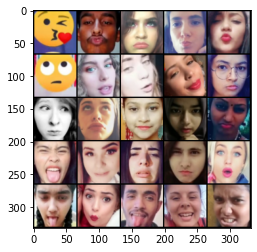

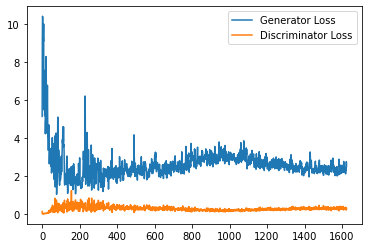

Step 33000: Generator loss: 2.378062341928482, discriminator loss: 0.2886984874904156


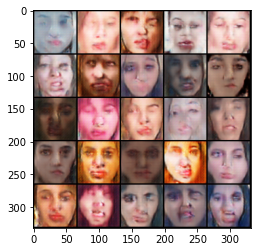

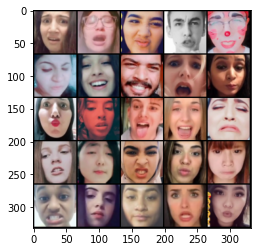

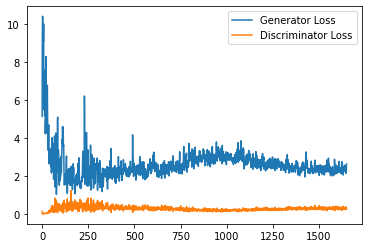

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 33500: Generator loss: 2.240702691793442, discriminator loss: 0.30770056289434433


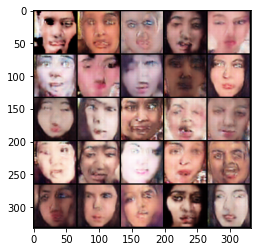

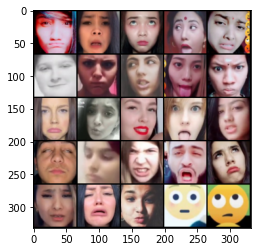

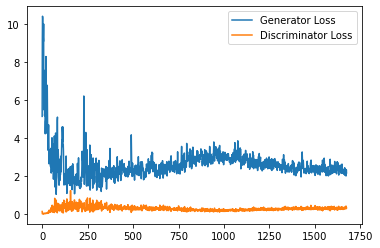

Step 34000: Generator loss: 2.274185114622116, discriminator loss: 0.31245985156297684


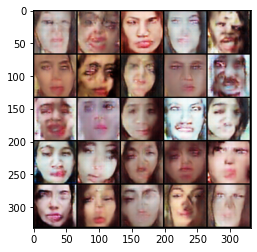

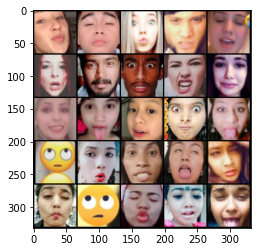

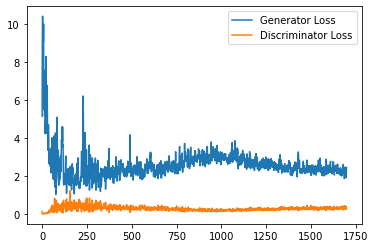

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 34500: Generator loss: 2.225909301519394, discriminator loss: 0.3058951779007912


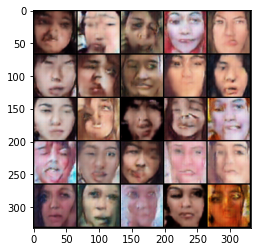

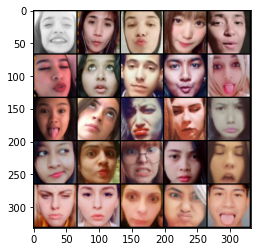

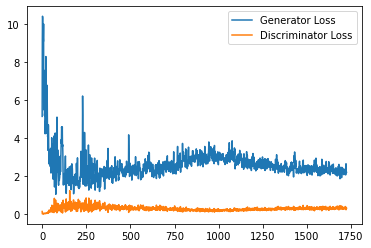

Step 35000: Generator loss: 2.305221048116684, discriminator loss: 0.3125075988471508


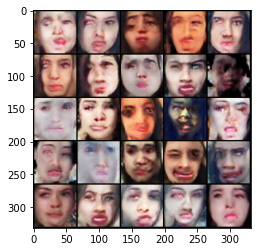

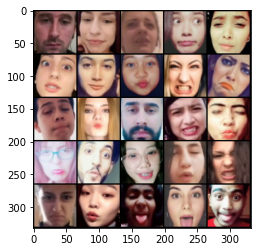

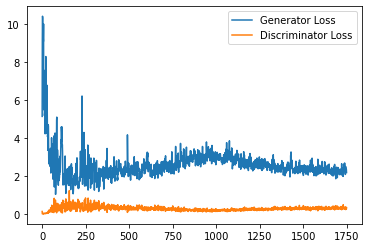

Step 35500: Generator loss: 2.2118809943199156, discriminator loss: 0.31631327521800995


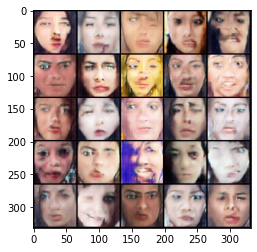

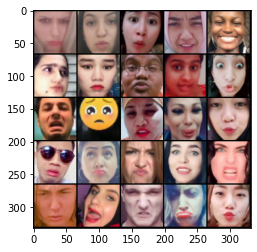

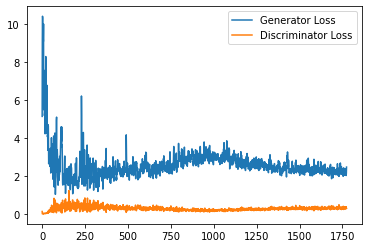

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 36000: Generator loss: 2.275355526685715, discriminator loss: 0.30570627492666247


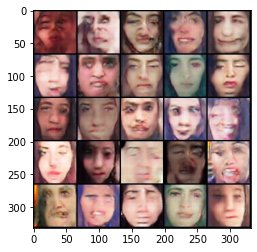

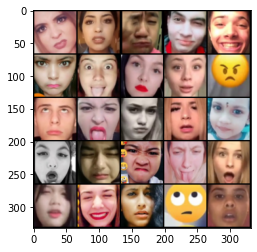

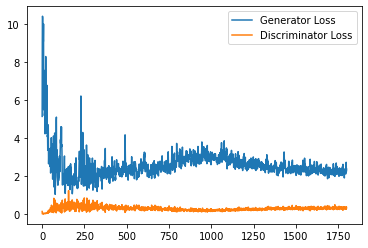

Step 36500: Generator loss: 2.2301892681121824, discriminator loss: 0.3104671567082405


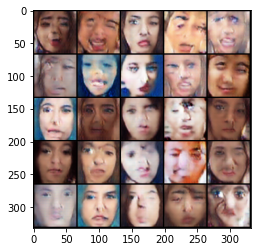

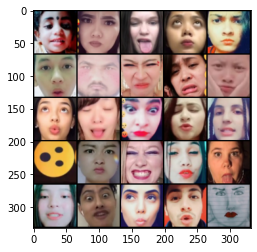

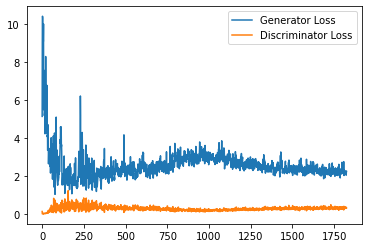

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 37000: Generator loss: 2.1906335475444796, discriminator loss: 0.3181267856955528


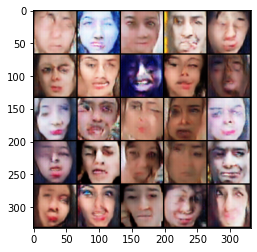

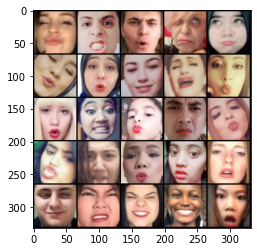

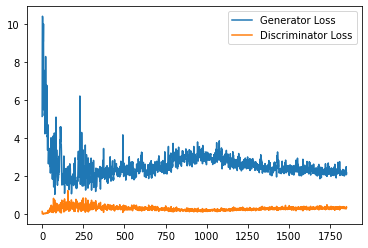

Step 37500: Generator loss: 2.2153491847515108, discriminator loss: 0.3120490762591362


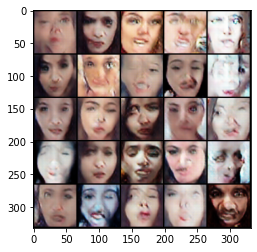

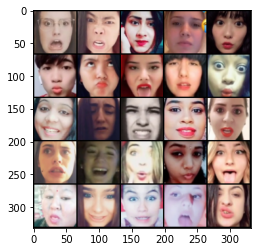

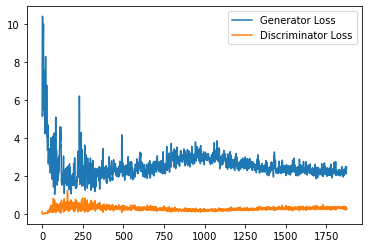

Step 38000: Generator loss: 2.1727454261779786, discriminator loss: 0.3353758608996868


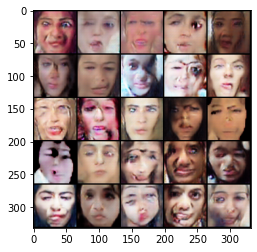

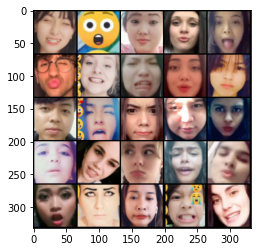

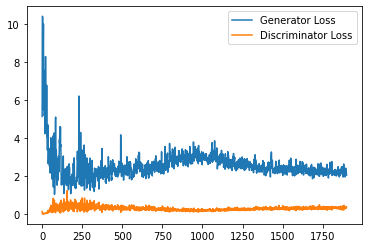

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 38500: Generator loss: 2.144006729364395, discriminator loss: 0.3232134747058153


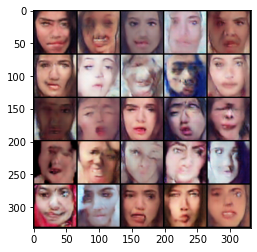

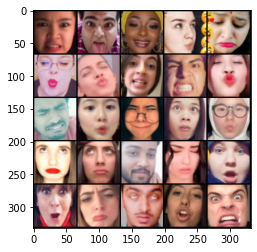

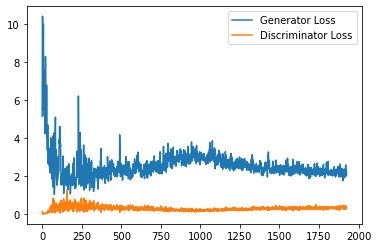

Step 39000: Generator loss: 2.1044345624446867, discriminator loss: 0.33506786918640136


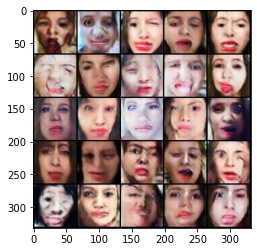

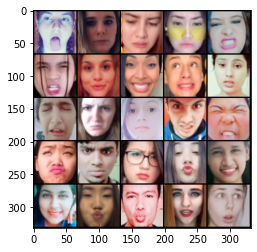

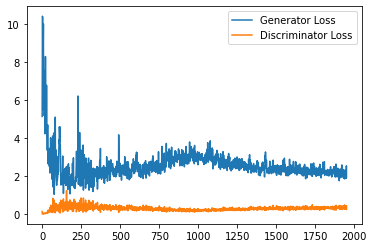

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 39500: Generator loss: 2.1708683960437773, discriminator loss: 0.32663232570886613


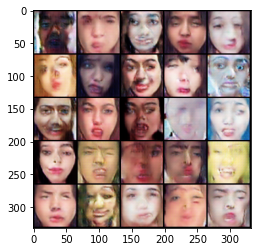

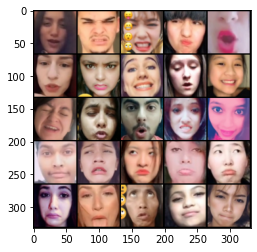

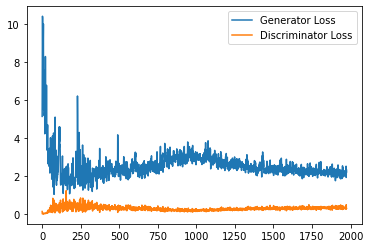

Step 40000: Generator loss: 2.107205777645111, discriminator loss: 0.336849347114563


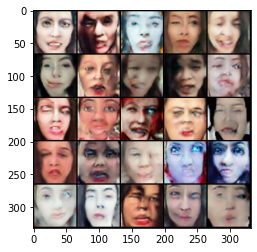

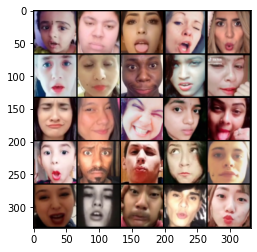

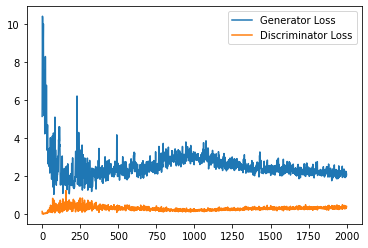

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 40500: Generator loss: 2.10618145942688, discriminator loss: 0.3397648015618324


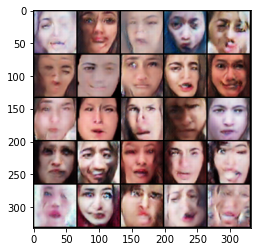

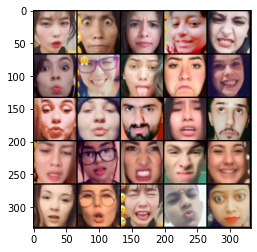

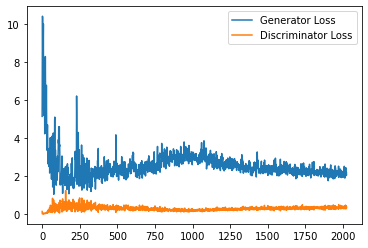

Step 41000: Generator loss: 2.118777358531952, discriminator loss: 0.33797381636500357


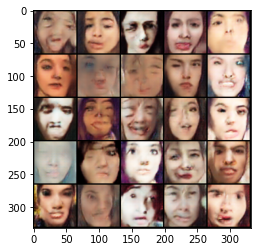

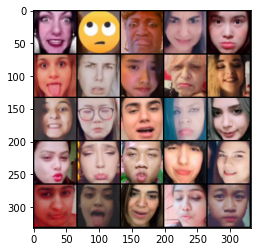

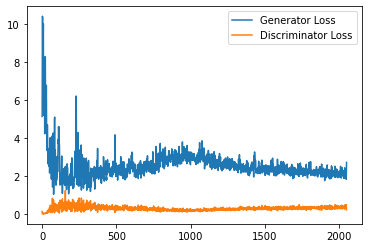

Step 41500: Generator loss: 1.9958975880146026, discriminator loss: 0.34883659121394156


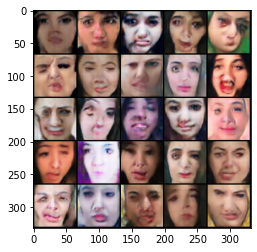

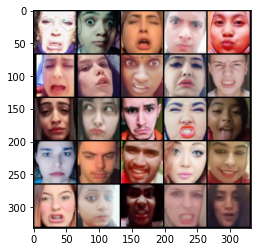

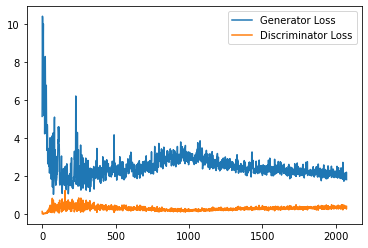

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 42000: Generator loss: 2.0503146419525144, discriminator loss: 0.3346576436161995


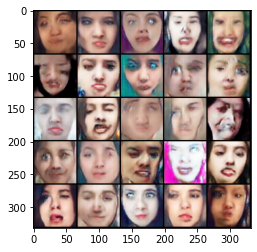

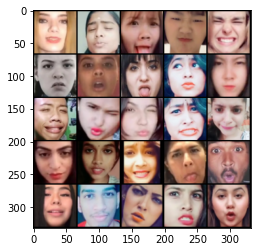

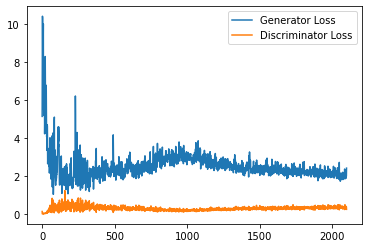

Step 42500: Generator loss: 2.0911749293804167, discriminator loss: 0.3558619649708271


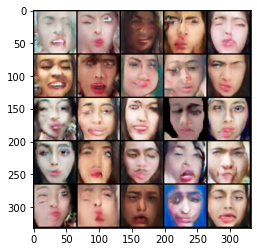

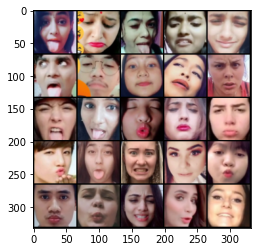

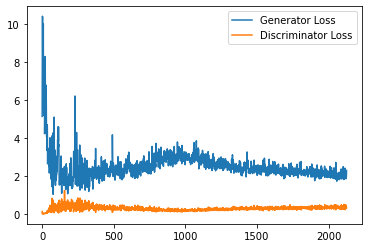

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 43000: Generator loss: 2.0307587065696717, discriminator loss: 0.34512204575538635


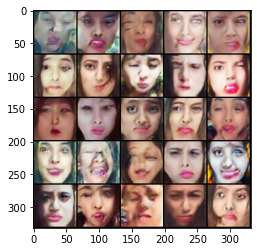

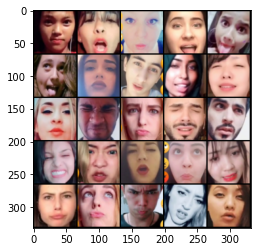

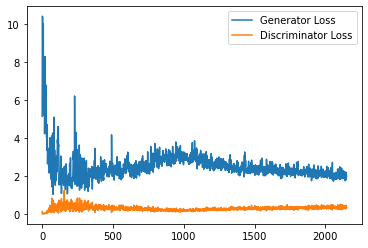

Step 43500: Generator loss: 1.9950063309669495, discriminator loss: 0.3476081931591034


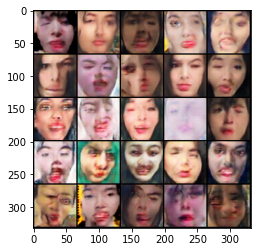

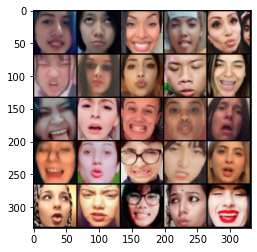

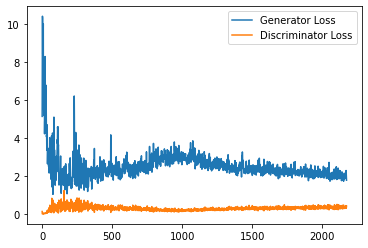

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 44000: Generator loss: 2.096866753578186, discriminator loss: 0.33765130215883254


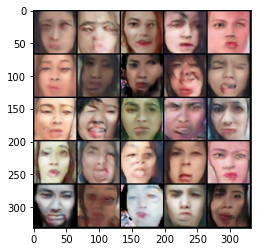

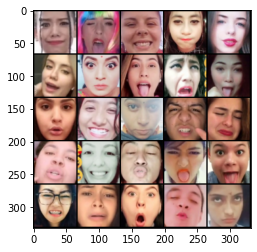

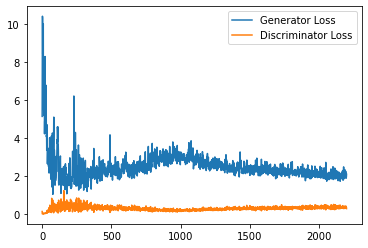

Step 44500: Generator loss: 2.0768382177352906, discriminator loss: 0.34921838229894636


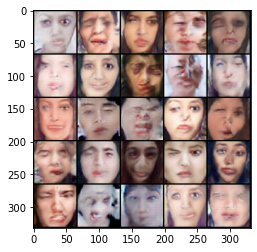

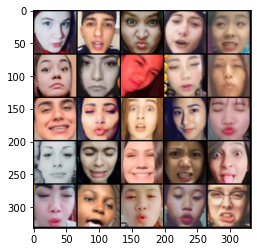

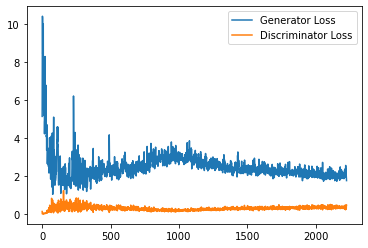

Step 45000: Generator loss: 2.0618614888191225, discriminator loss: 0.35061935490369794


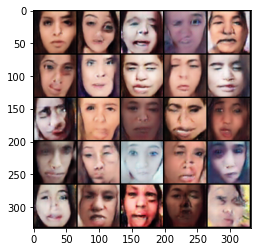

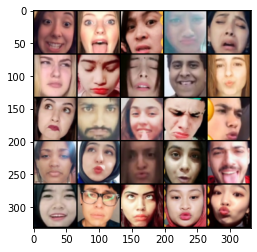

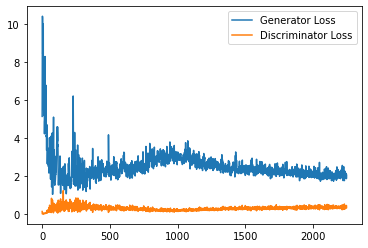

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 45500: Generator loss: 2.0165917732715606, discriminator loss: 0.3414694602191448


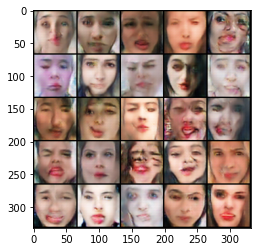

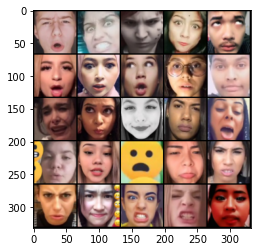

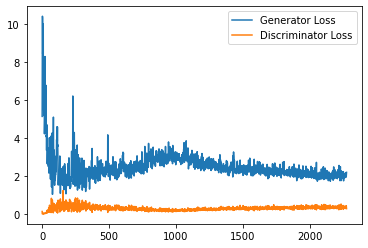

Step 46000: Generator loss: 1.9730623109340668, discriminator loss: 0.3535150215625763


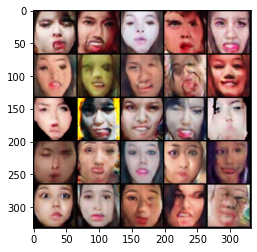

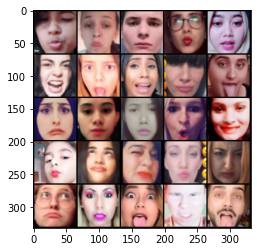

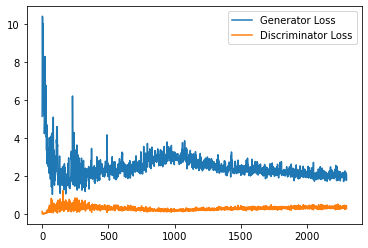

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 46500: Generator loss: 2.1076366515159606, discriminator loss: 0.34737083879113195


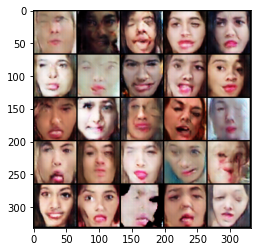

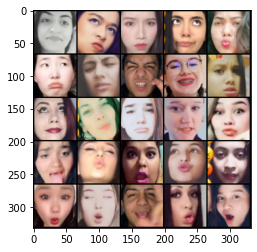

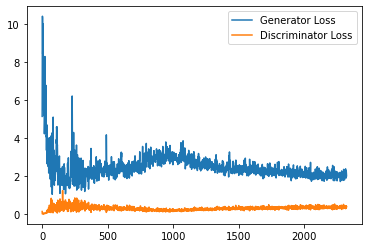

Step 47000: Generator loss: 2.031329213619232, discriminator loss: 0.3545130133032799


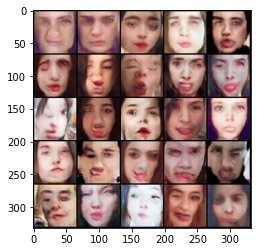

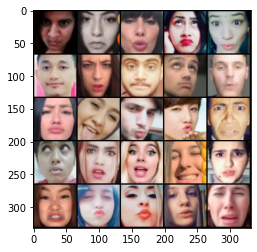

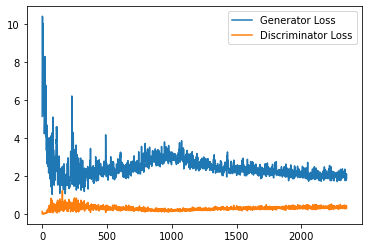

Step 47500: Generator loss: 1.9875758776664734, discriminator loss: 0.3516376132369041


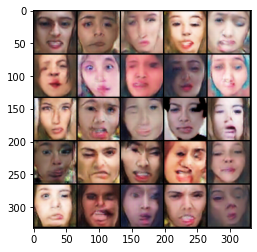

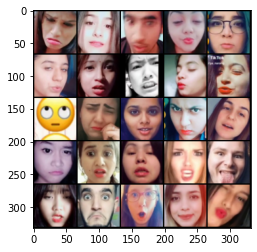

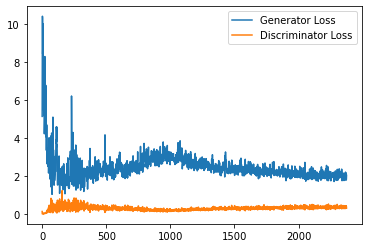

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 48000: Generator loss: 1.9784285695552826, discriminator loss: 0.35774524852633477


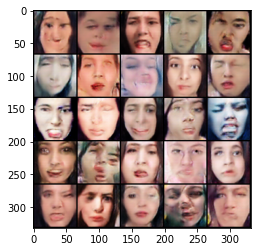

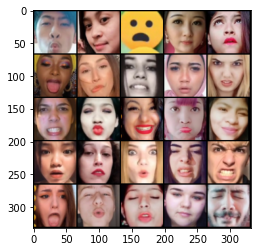

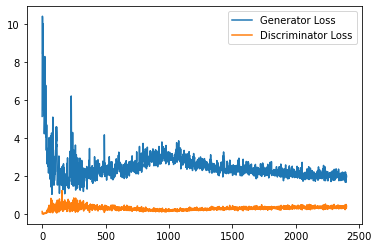

Step 48500: Generator loss: 1.9379281840324403, discriminator loss: 0.3645709607601166


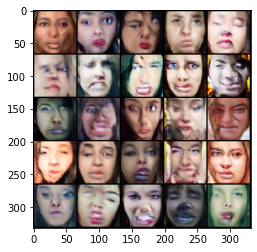

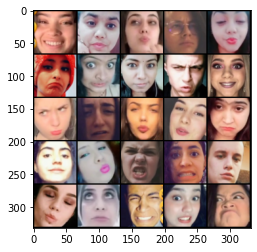

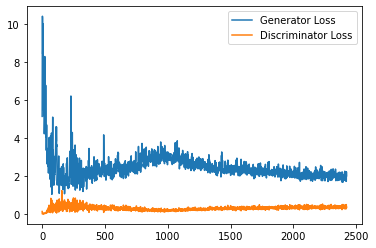

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 49000: Generator loss: 2.042880072116852, discriminator loss: 0.3642449963390827


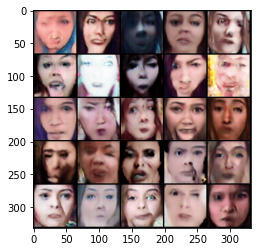

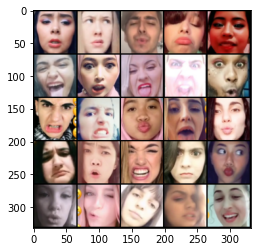

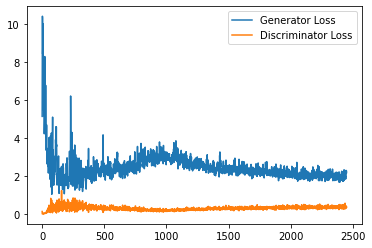

Step 49500: Generator loss: 1.9421315069198608, discriminator loss: 0.3579947090446949


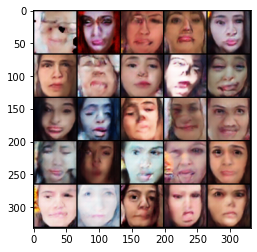

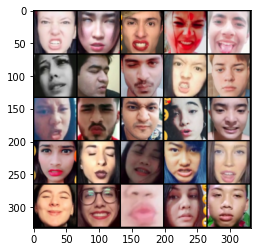

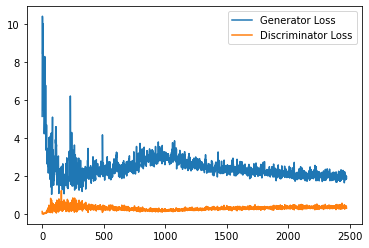

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 50000: Generator loss: 1.965346914768219, discriminator loss: 0.367825639039278


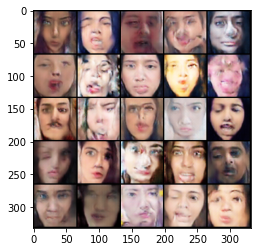

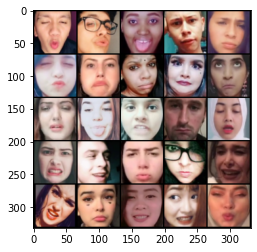

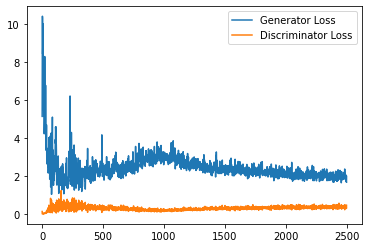

Step 50500: Generator loss: 1.9563417718410492, discriminator loss: 0.3619887878298759


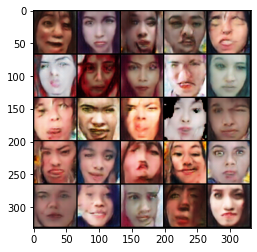

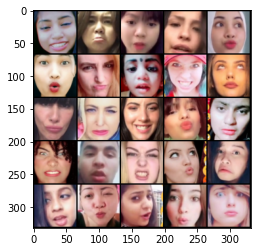

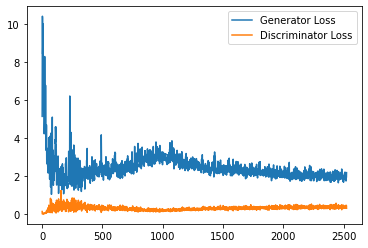

Step 51000: Generator loss: 1.9570774869918823, discriminator loss: 0.3646034786403179


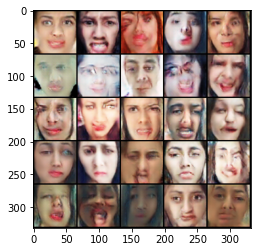

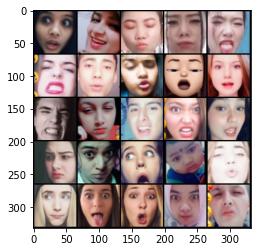

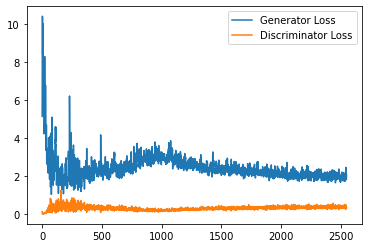

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 51500: Generator loss: 1.9678215444087983, discriminator loss: 0.3613458414673805


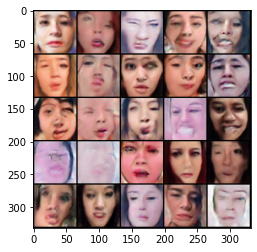

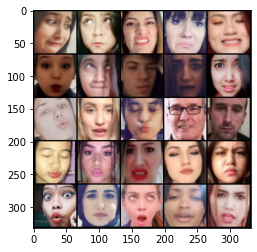

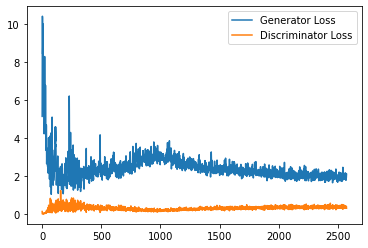

Step 52000: Generator loss: 1.9825080444812775, discriminator loss: 0.36016048842668535


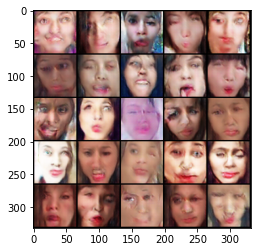

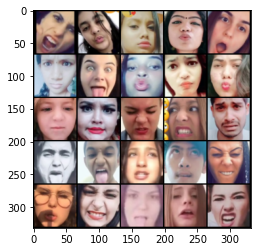

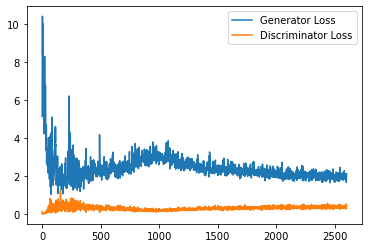

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 52500: Generator loss: 1.9065090985298156, discriminator loss: 0.3720342119336128


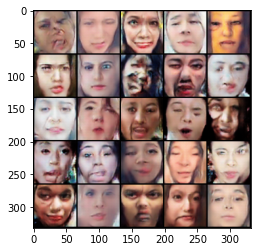

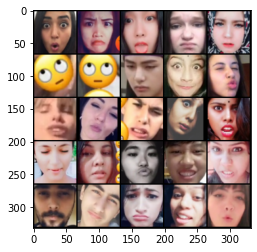

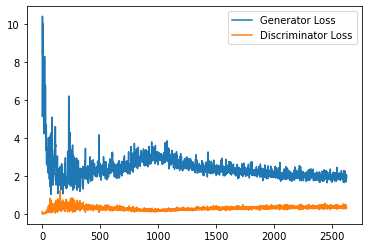

Step 53000: Generator loss: 1.932570458650589, discriminator loss: 0.36743534085154533


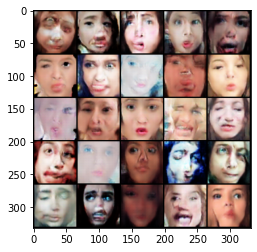

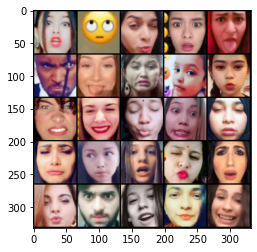

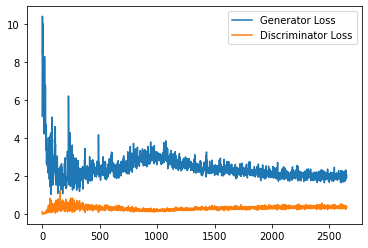

Step 53500: Generator loss: 1.9659083940982818, discriminator loss: 0.35794416508078575


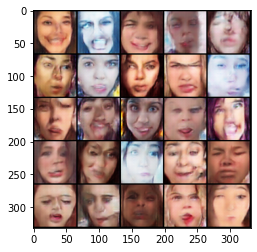

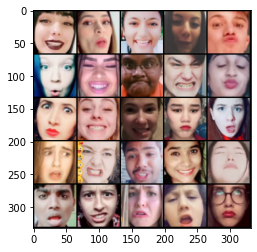

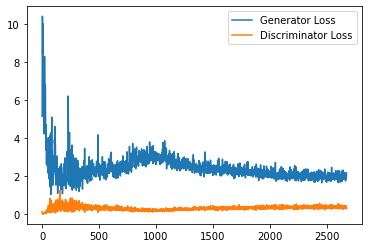

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 54000: Generator loss: 2.006209322690964, discriminator loss: 0.36922122034430505


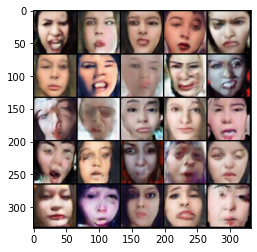

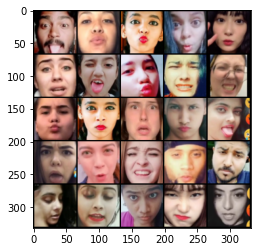

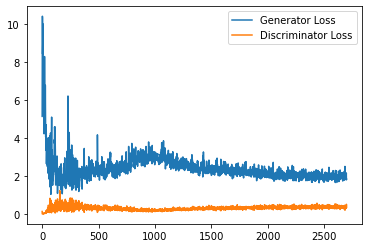

Step 54500: Generator loss: 1.897118047475815, discriminator loss: 0.3675196688771248


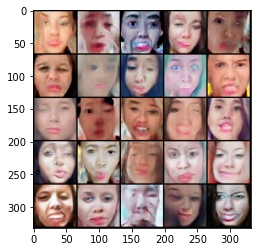

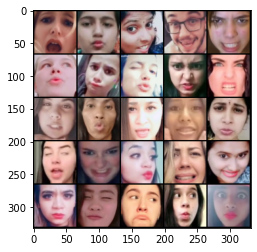

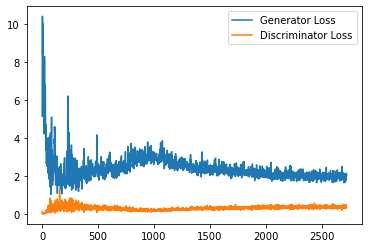

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 55000: Generator loss: 1.9611742422580718, discriminator loss: 0.36806544569134714


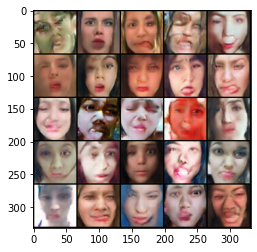

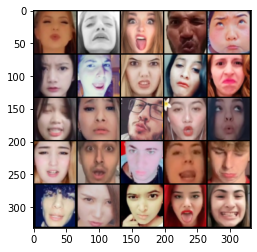

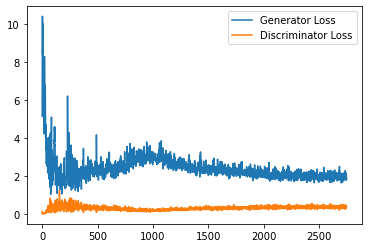

Step 55500: Generator loss: 1.9448886375427246, discriminator loss: 0.3668944401741028


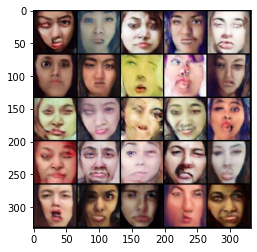

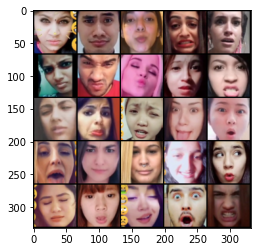

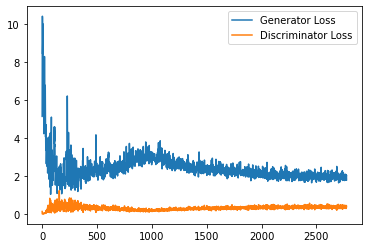

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 56000: Generator loss: 1.988374524116516, discriminator loss: 0.35873042929172516


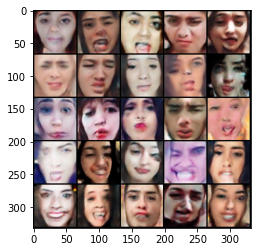

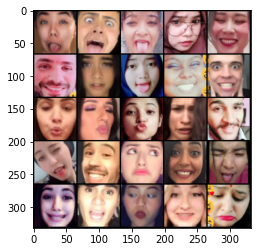

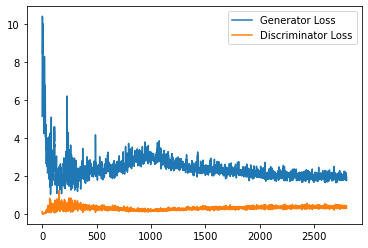

Step 56500: Generator loss: 1.897879940032959, discriminator loss: 0.367065620213747


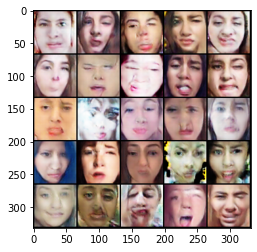

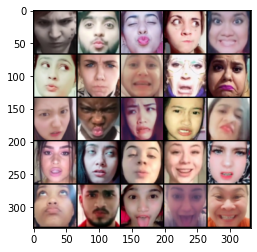

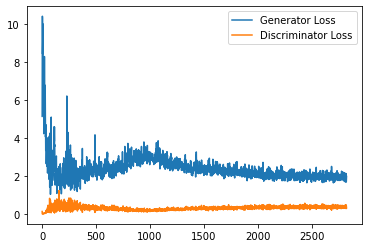

Step 57000: Generator loss: 1.9314251661300659, discriminator loss: 0.3698877745270729


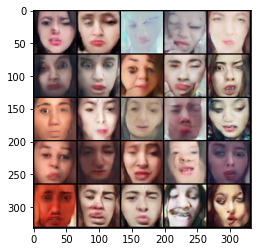

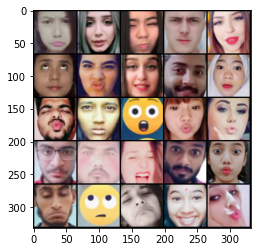

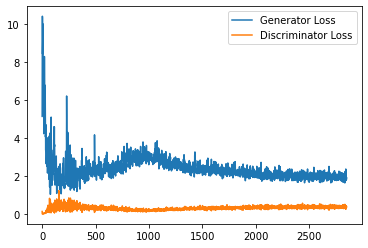

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 57500: Generator loss: 1.953345983028412, discriminator loss: 0.3645681862533092


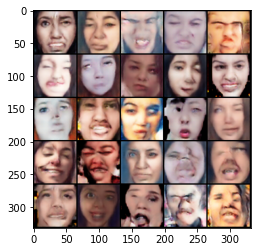

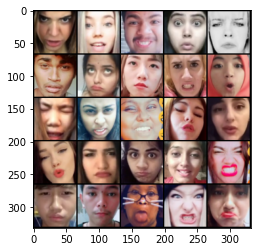

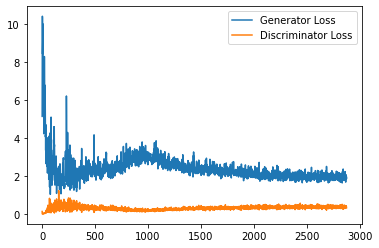

Step 58000: Generator loss: 1.9219368572235107, discriminator loss: 0.3599054552912712


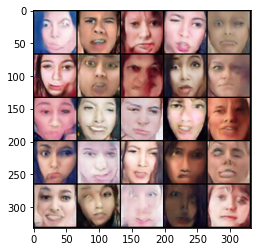

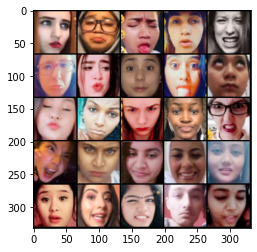

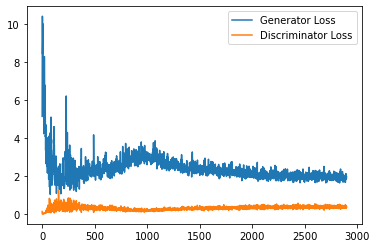

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 58500: Generator loss: 1.9444720385074616, discriminator loss: 0.3682715264856815


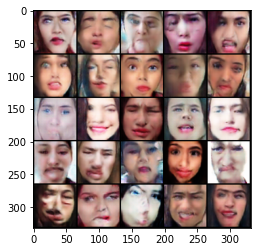

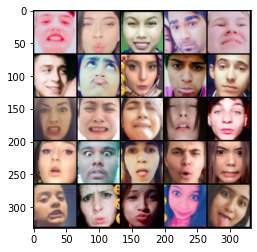

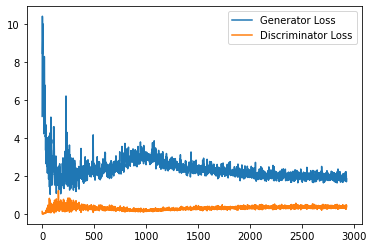

Step 59000: Generator loss: 1.9411368923187255, discriminator loss: 0.3625958581864834


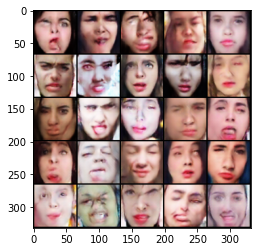

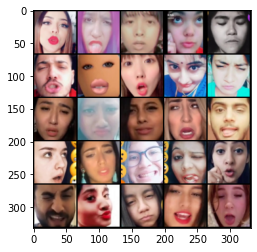

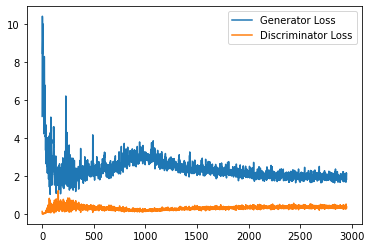

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 59500: Generator loss: 2.0383233993053436, discriminator loss: 0.3502494889199734


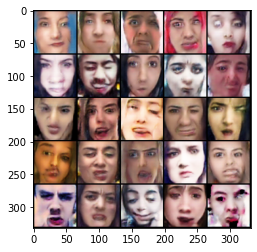

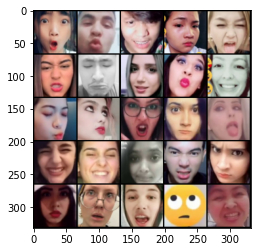

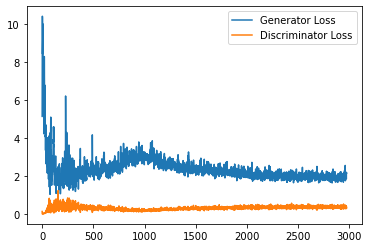

Step 60000: Generator loss: 1.9263618376255036, discriminator loss: 0.36261038851737976


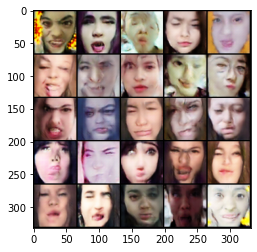

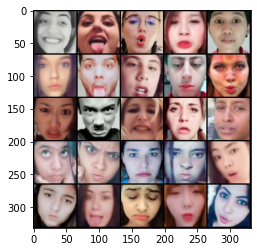

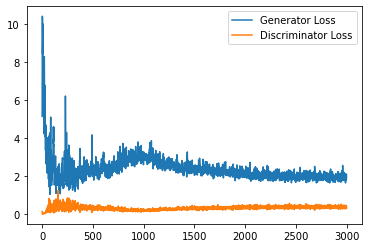

Step 60500: Generator loss: 1.9751699733734132, discriminator loss: 0.3686377476155758


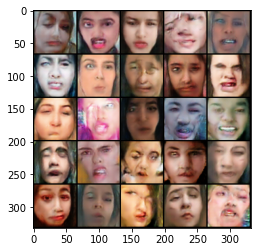

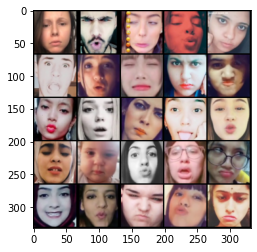

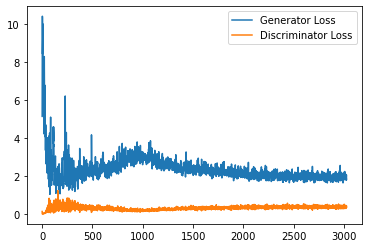

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 61000: Generator loss: 1.8760141758918762, discriminator loss: 0.3784431462287903


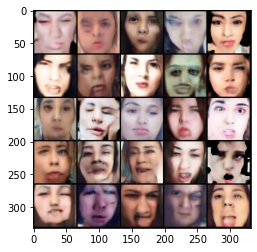

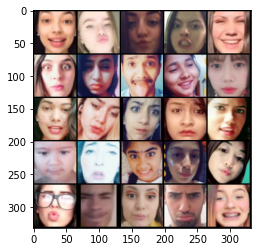

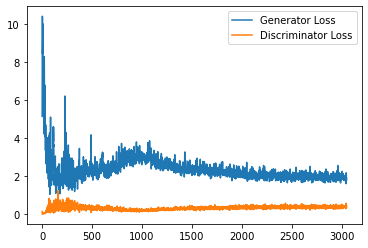

Step 61500: Generator loss: 1.8545118815898896, discriminator loss: 0.3690454684495926


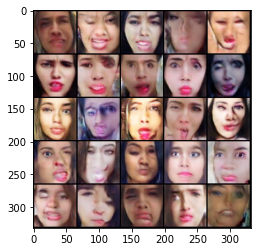

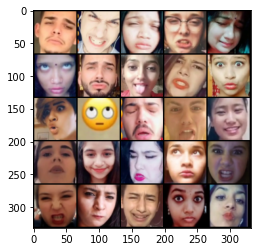

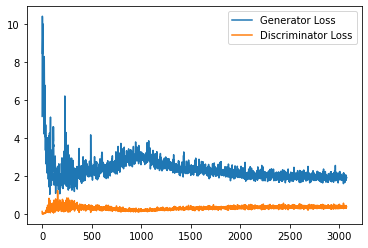

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 62000: Generator loss: 1.929282504081726, discriminator loss: 0.36989265877008437


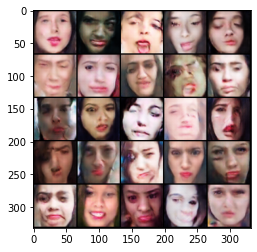

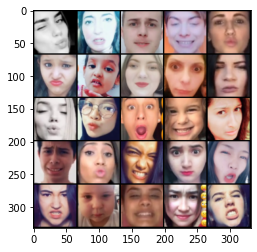

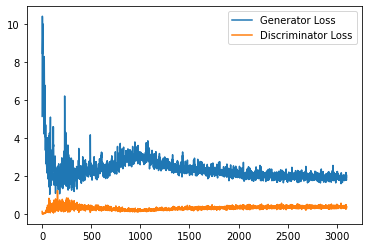

Step 62500: Generator loss: 1.9549903266429902, discriminator loss: 0.35399920904636384


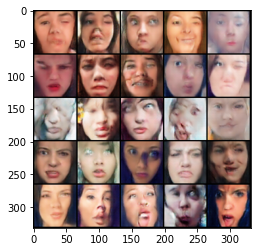

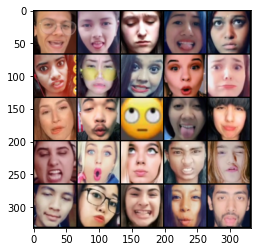

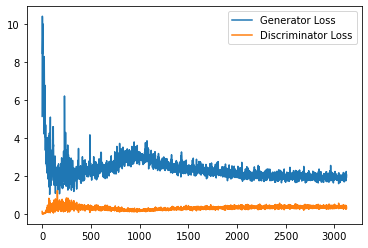

Step 63000: Generator loss: 1.9519035193920136, discriminator loss: 0.3590813661813736


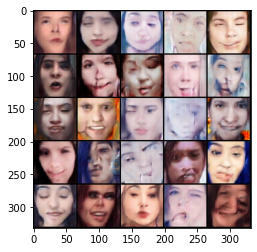

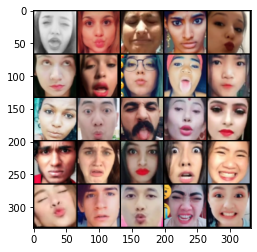

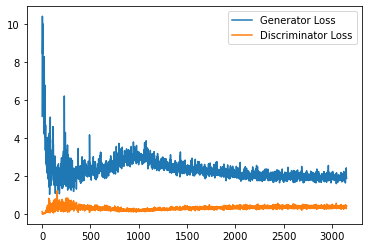

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 63500: Generator loss: 1.93691205906868, discriminator loss: 0.3634005474448204


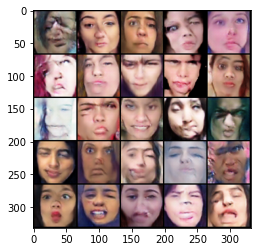

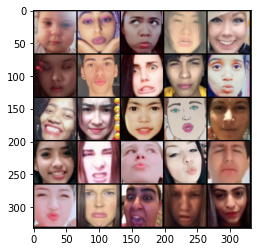

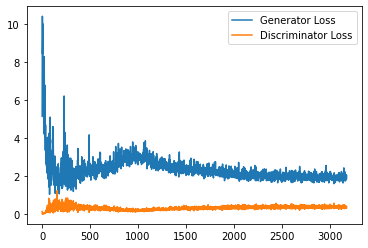

Step 64000: Generator loss: 1.9812968401908875, discriminator loss: 0.3634483951628208


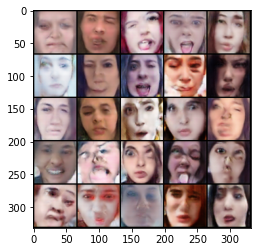

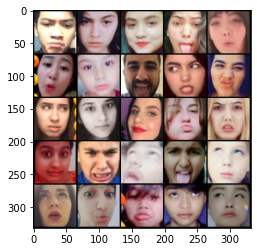

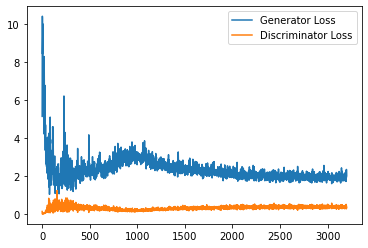

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 64500: Generator loss: 1.9175537042617798, discriminator loss: 0.3633669594526291


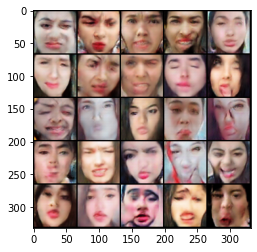

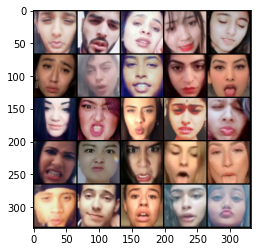

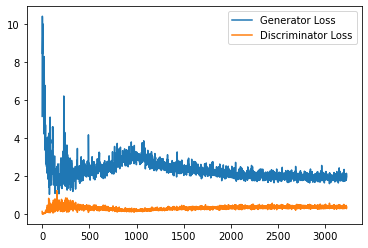

Step 65000: Generator loss: 1.9562875006198883, discriminator loss: 0.3557234596014023


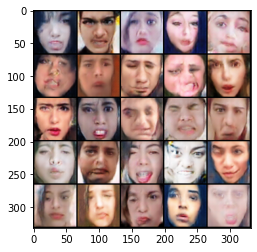

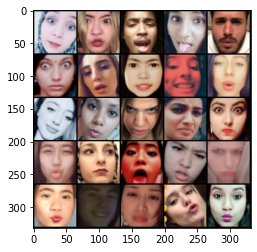

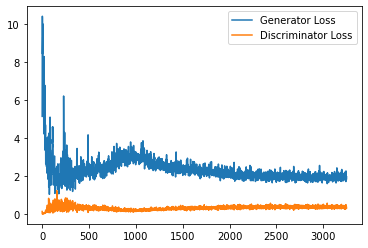

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 65500: Generator loss: 1.9443432369232179, discriminator loss: 0.35641373243927954


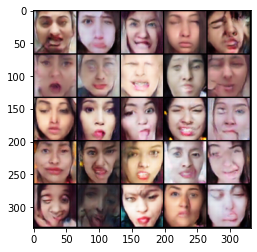

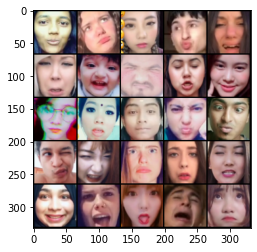

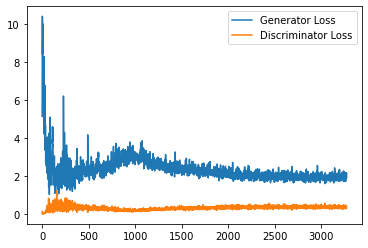

Step 66000: Generator loss: 1.9925278675556184, discriminator loss: 0.3585940520465374


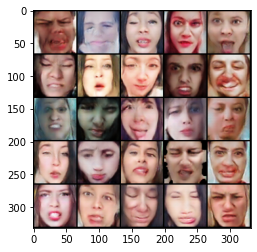

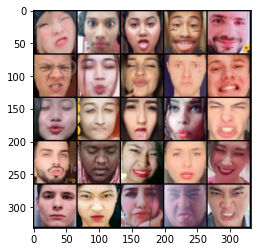

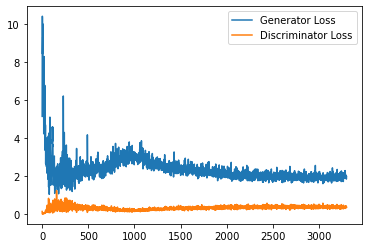

Step 66500: Generator loss: 1.913626220226288, discriminator loss: 0.3586996533870697


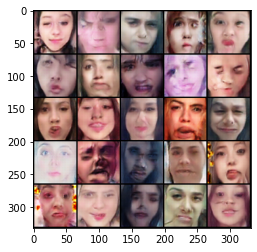

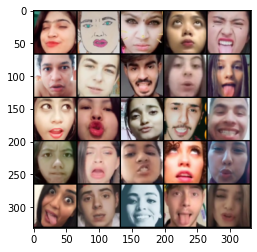

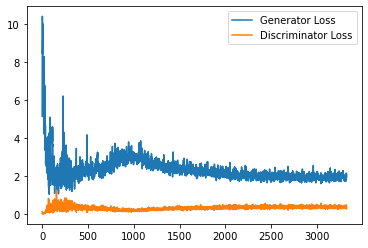

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 67000: Generator loss: 1.9562909967899322, discriminator loss: 0.36924578219652177


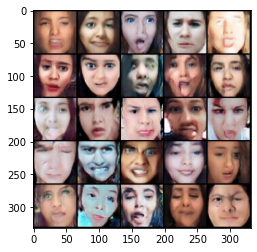

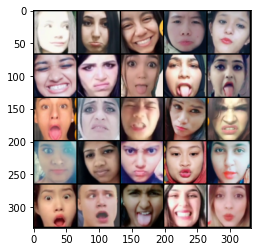

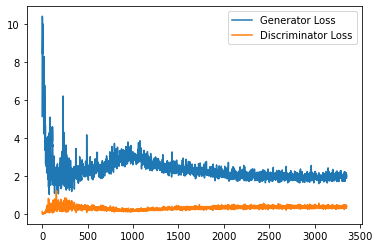

Step 67500: Generator loss: 1.9744998764991761, discriminator loss: 0.362931903898716


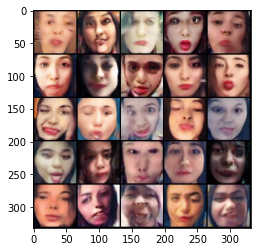

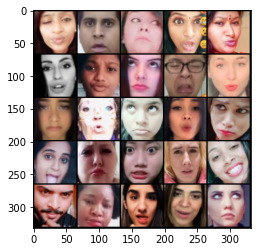

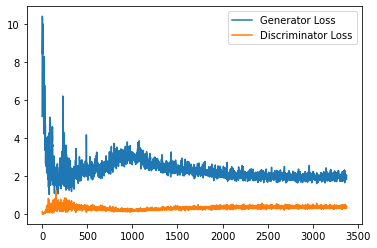

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 68000: Generator loss: 1.9148757672309875, discriminator loss: 0.3633311056494713


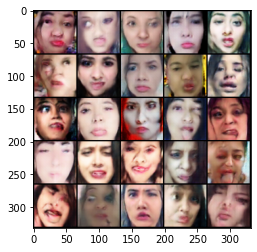

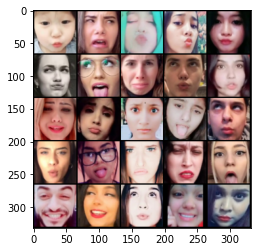

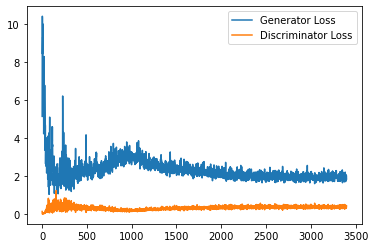

Step 68500: Generator loss: 1.9759424228668212, discriminator loss: 0.3579691267311573


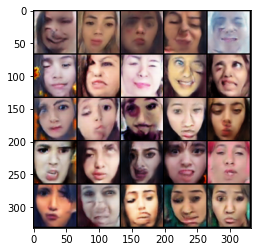

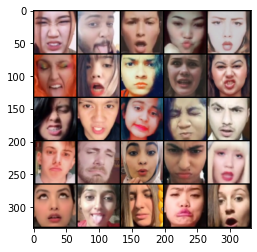

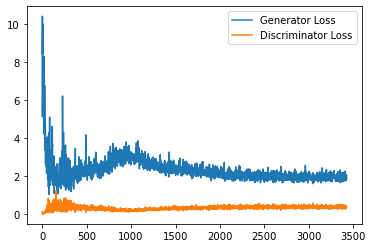

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 69000: Generator loss: 1.9854921469688416, discriminator loss: 0.36454683405160904


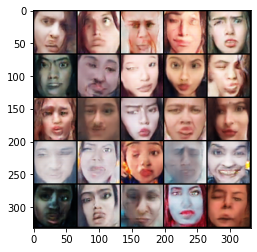

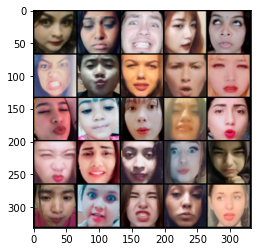

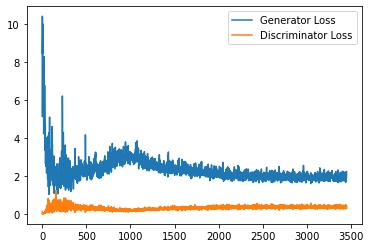

Step 69500: Generator loss: 1.9947313108444213, discriminator loss: 0.35614294168353083


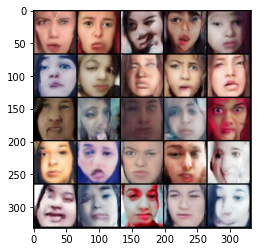

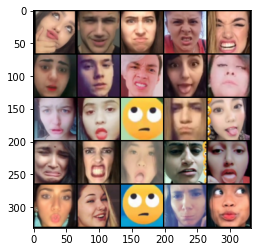

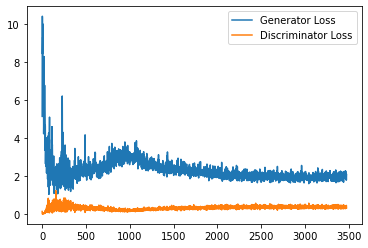

Step 70000: Generator loss: 1.9135700948238372, discriminator loss: 0.36696554777026175


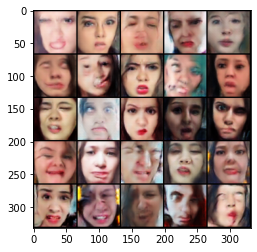

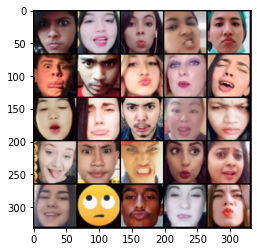

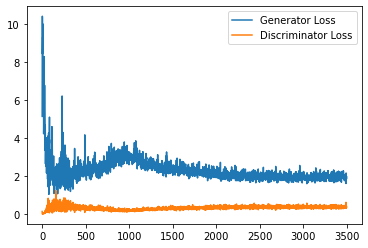

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 70500: Generator loss: 1.9798371903896332, discriminator loss: 0.35455251148343087


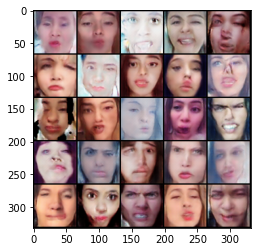

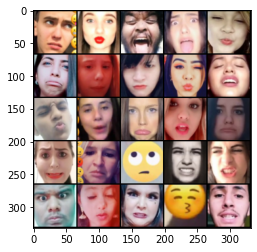

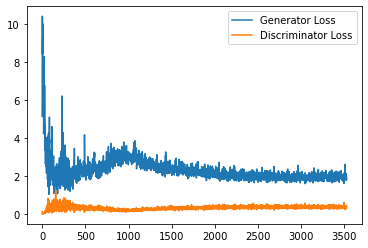

Step 71000: Generator loss: 1.9372823879718781, discriminator loss: 0.36152234438061714


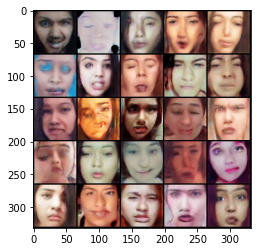

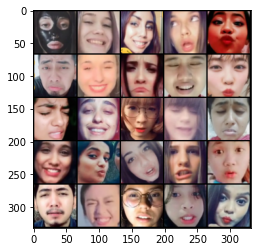

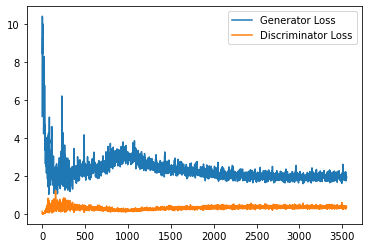

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 71500: Generator loss: 1.952643575668335, discriminator loss: 0.35686102586984636


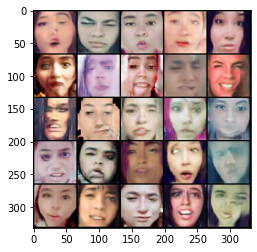

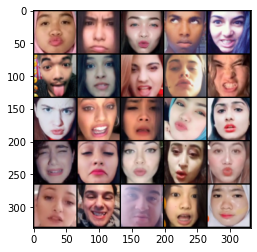

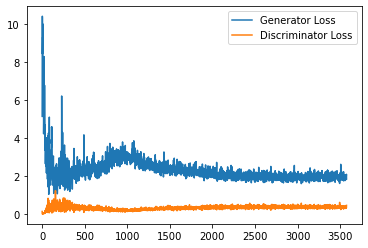

Step 72000: Generator loss: 2.026975245952606, discriminator loss: 0.3485658637285233


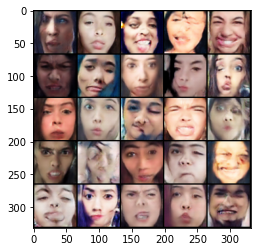

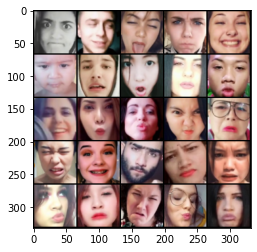

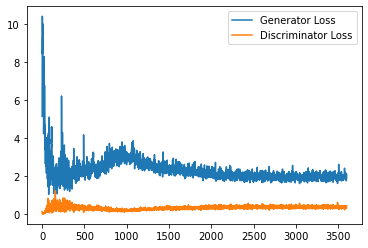

Step 72500: Generator loss: 1.981252965927124, discriminator loss: 0.36062647065520287


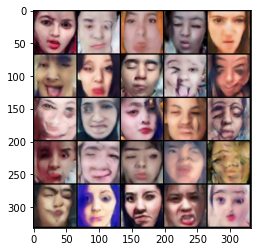

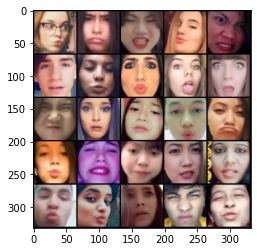

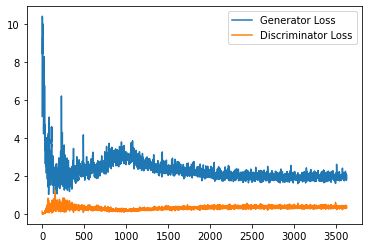

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 73000: Generator loss: 2.026458531856537, discriminator loss: 0.3493478409051895


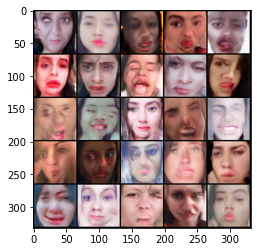

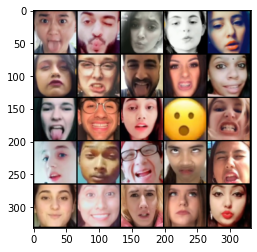

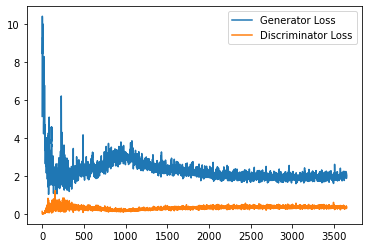

Step 73500: Generator loss: 1.9526320140361786, discriminator loss: 0.36141477346420287


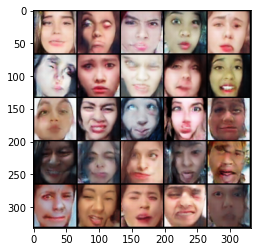

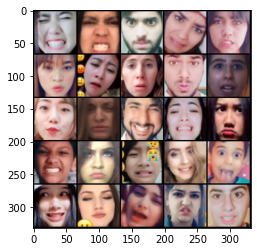

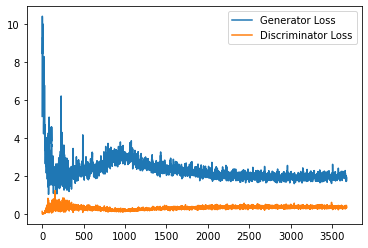

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 74000: Generator loss: 2.033750634431839, discriminator loss: 0.35381448855996134


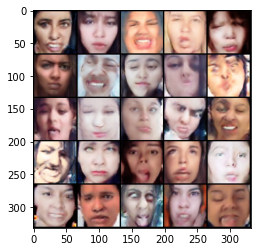

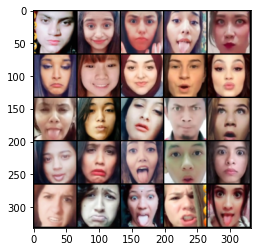

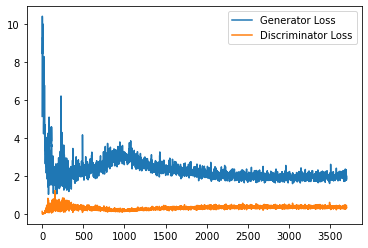

Step 74500: Generator loss: 1.9498810741901398, discriminator loss: 0.35154238909482954


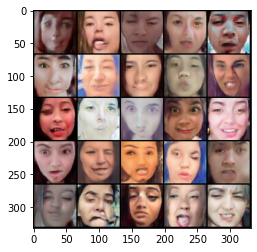

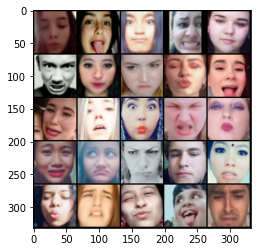

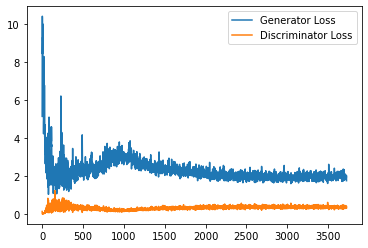

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 75000: Generator loss: 1.960471059322357, discriminator loss: 0.34886774283647537


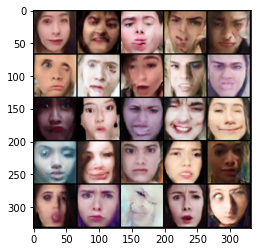

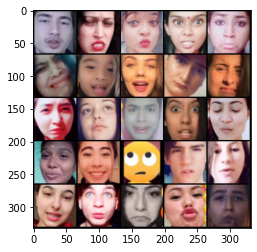

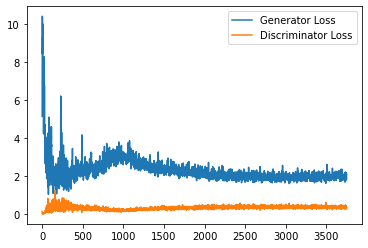

Step 75500: Generator loss: 2.0463701095581053, discriminator loss: 0.349803645670414


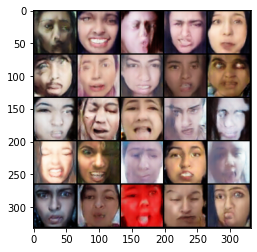

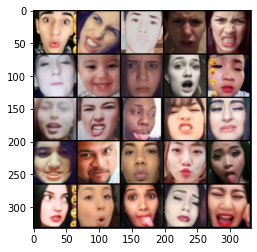

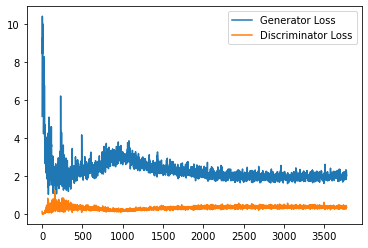

Step 76000: Generator loss: 2.024808964252472, discriminator loss: 0.35879174414277076


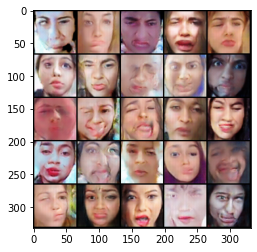

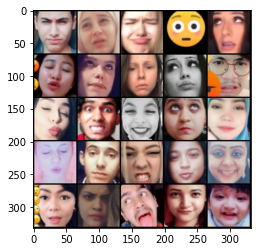

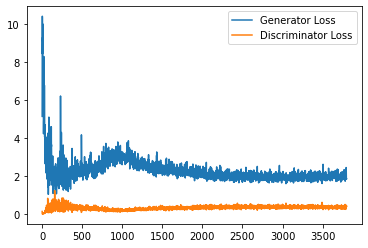

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 76500: Generator loss: 1.970349999189377, discriminator loss: 0.3549590963423252


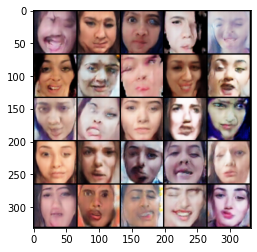

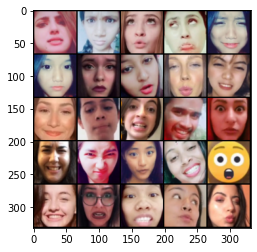

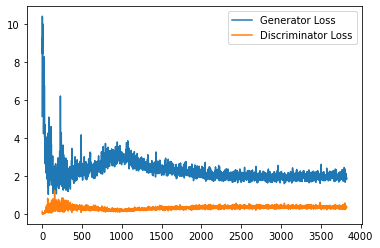

Step 77000: Generator loss: 1.9521234788894652, discriminator loss: 0.3529124169051647


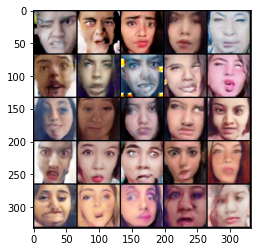

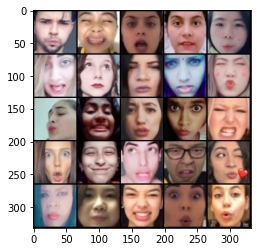

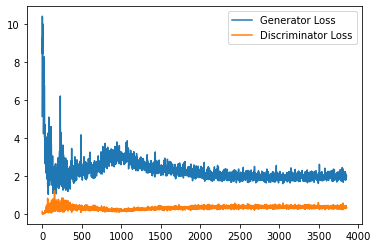

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 77500: Generator loss: 2.0404728951454163, discriminator loss: 0.3504672979414463


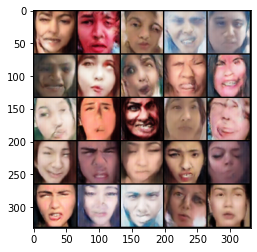

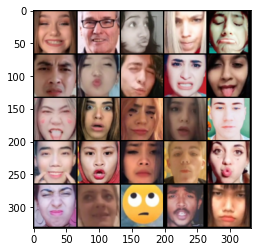

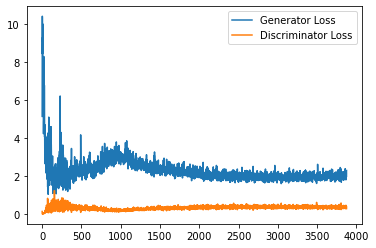

Step 78000: Generator loss: 2.0335379657745363, discriminator loss: 0.35545398339629175


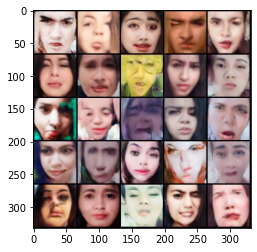

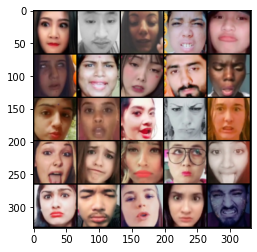

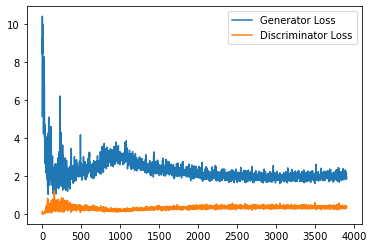

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 78500: Generator loss: 1.951277693271637, discriminator loss: 0.3492793574929237


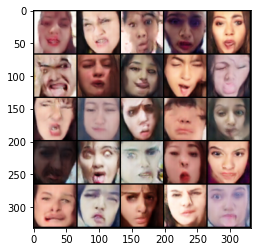

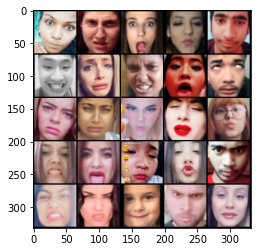

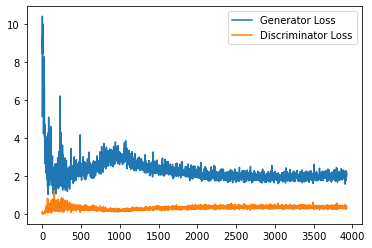

Step 79000: Generator loss: 1.9933145174980162, discriminator loss: 0.34587243297696113


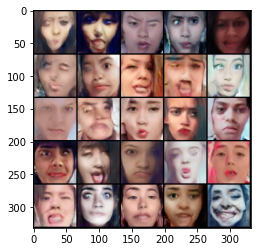

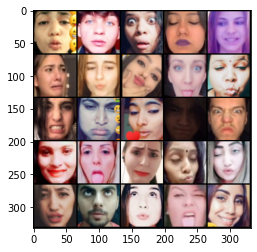

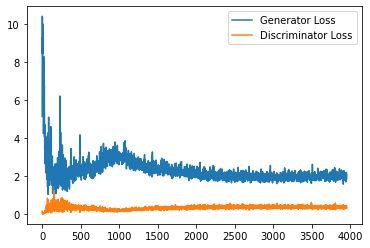

Step 79500: Generator loss: 2.0088395438194273, discriminator loss: 0.35210535046458247


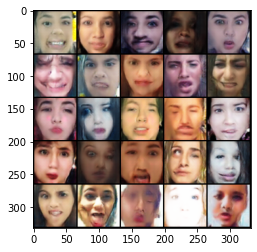

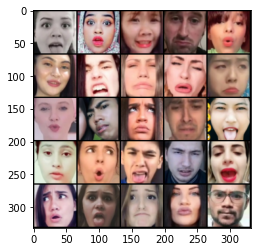

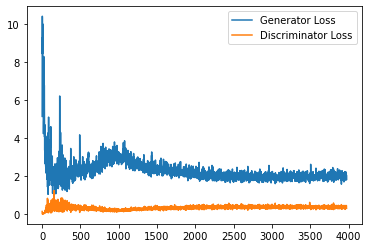

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 80000: Generator loss: 1.9870719769001006, discriminator loss: 0.35000399926304815


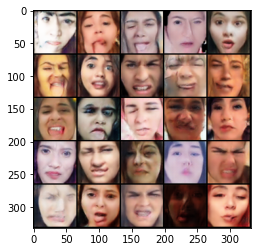

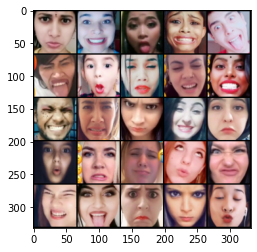

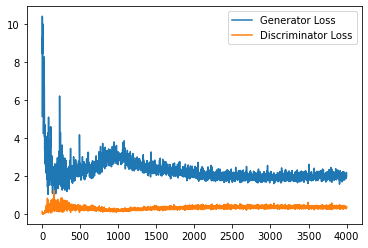

Step 80500: Generator loss: 2.0042831103801726, discriminator loss: 0.34829826626181604


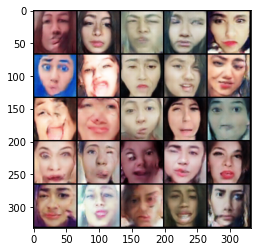

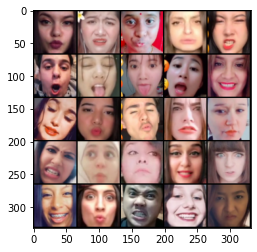

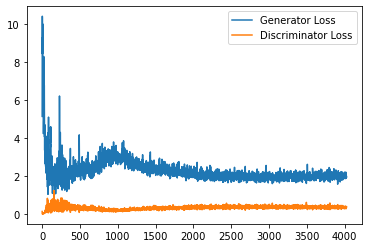

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 81000: Generator loss: 2.0083284616470336, discriminator loss: 0.3594105152785778


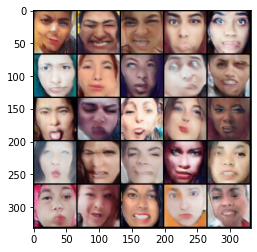

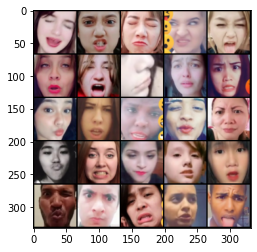

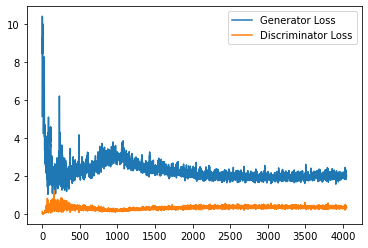

Step 81500: Generator loss: 2.058781096458435, discriminator loss: 0.3493611758649349


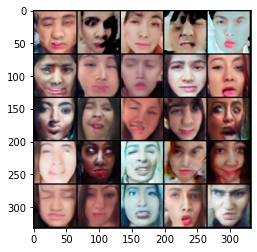

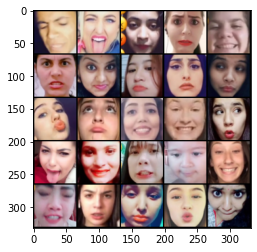

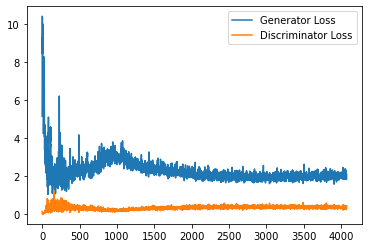

Step 82000: Generator loss: 1.9912271406650544, discriminator loss: 0.35042227792739866


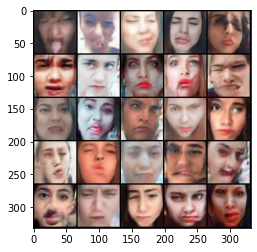

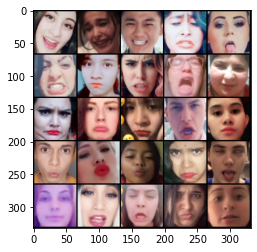

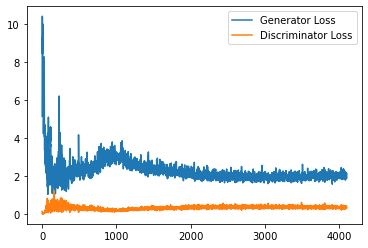

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 82500: Generator loss: 2.020070612668991, discriminator loss: 0.34122098964452746


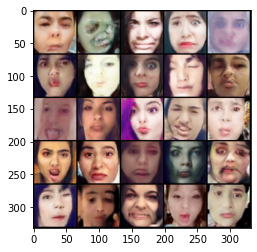

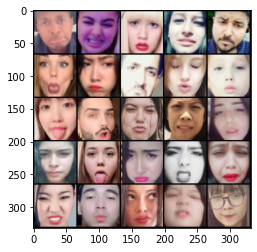

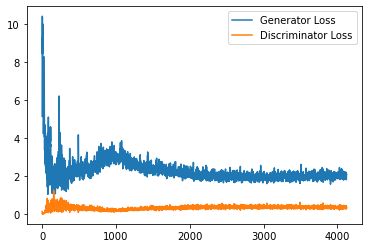

Step 83000: Generator loss: 2.0055743668079375, discriminator loss: 0.35223974648118017


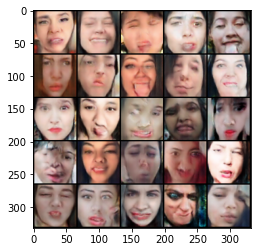

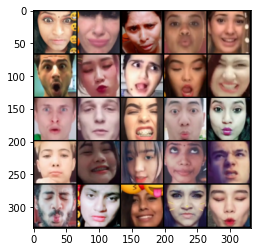

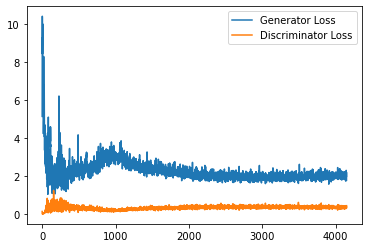

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 83500: Generator loss: 1.9499149856567384, discriminator loss: 0.34829078954458237


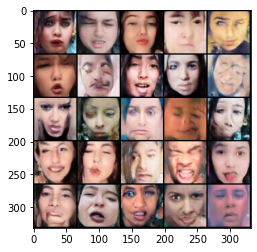

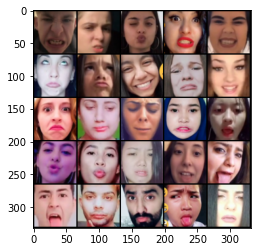

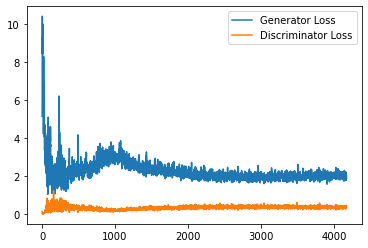

Step 84000: Generator loss: 2.0264154551029203, discriminator loss: 0.34563952979445456


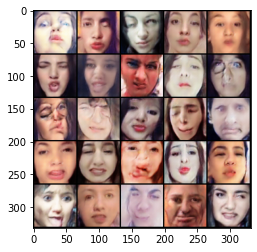

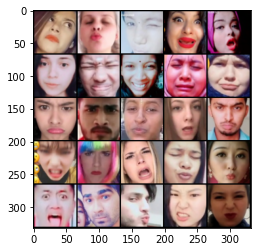

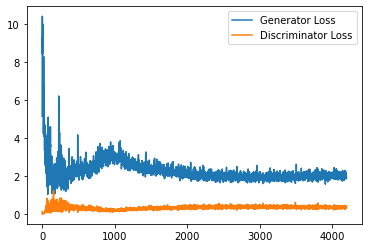

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 84500: Generator loss: 2.0110465099811554, discriminator loss: 0.3481880212128162


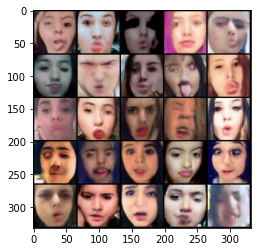

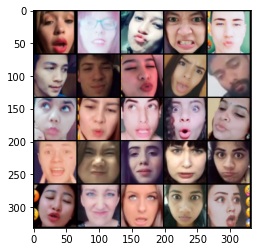

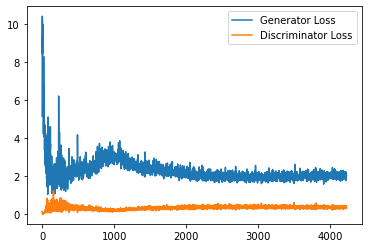

Step 85000: Generator loss: 2.024960396528244, discriminator loss: 0.3483457493185997


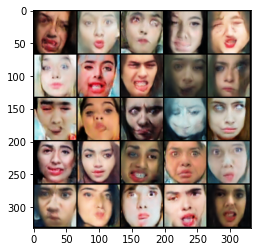

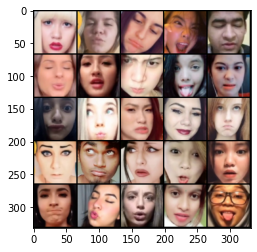

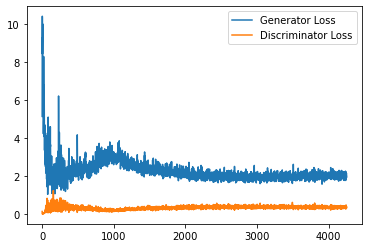

Step 85500: Generator loss: 2.0507421975135802, discriminator loss: 0.33996138364076617


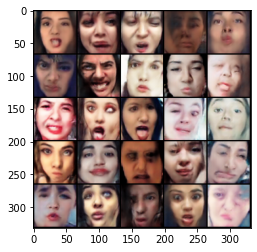

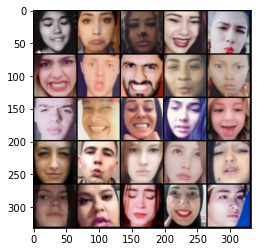

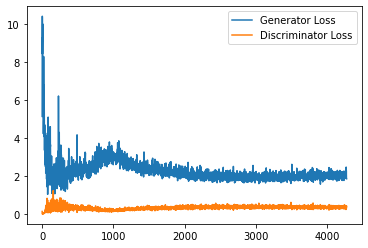

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 86000: Generator loss: 2.018393586397171, discriminator loss: 0.3484237715601921


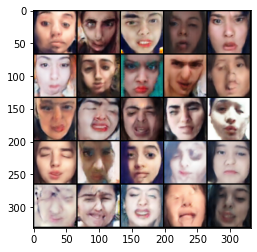

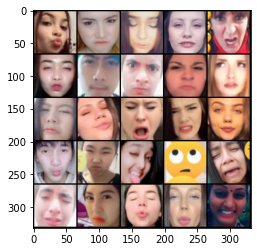

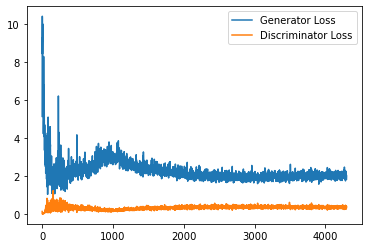

Step 86500: Generator loss: 2.005312716245651, discriminator loss: 0.3404917608499527


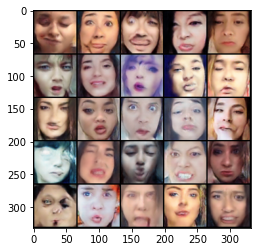

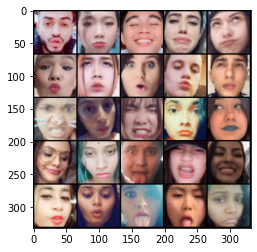

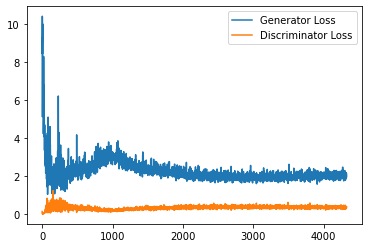

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 87000: Generator loss: 2.0864376029968263, discriminator loss: 0.33885005074739455


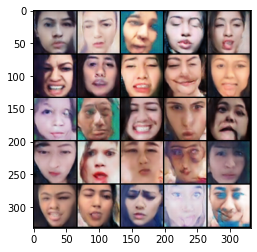

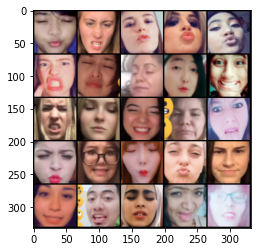

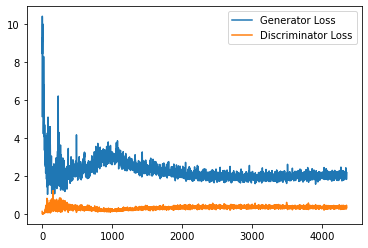

Step 87500: Generator loss: 2.037708667039871, discriminator loss: 0.3381212443709373


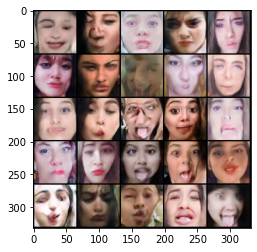

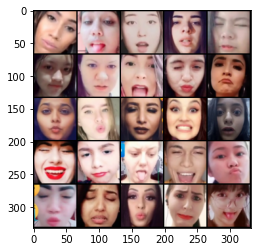

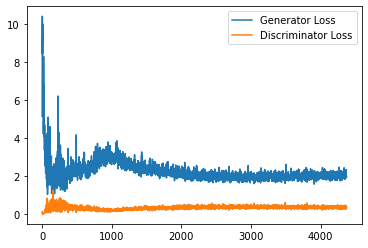

  0%|          | 0/1189 [00:00<?, ?it/s]

Step 88000: Generator loss: 2.043276549577713, discriminator loss: 0.33730535161495206


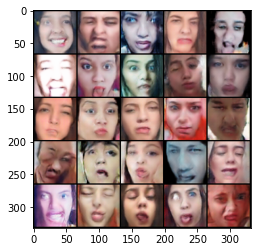

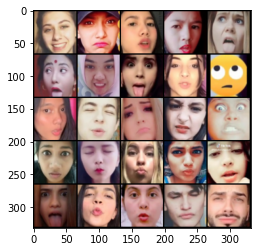

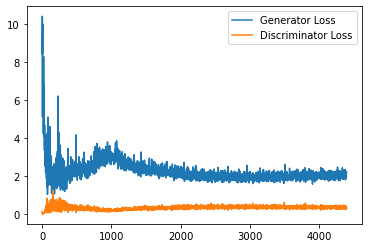

In [ ]:
def train(n_epochs, dataloader, gen, gen_opt, disc, disc_opt)
    cur_step = 0
    generator_losses = []
    discriminator_losses = []

    noise_and_labels = False
    fake = False

    fake_image_and_labels = False
    real_image_and_labels = False
    disc_fake_pred = False
    disc_real_pred = False

    for epoch in range(n_epochs):
        # Dataloader returns the batches and the labels
        for real, labels in tqdm(dataloader):
            cur_batch_size = len(real)
            # Flatten the batch of real images from the dataset
            real = real.to(device)

            one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
            image_one_hot_labels = one_hot_labels[:, :, None, None]
            image_one_hot_labels = image_one_hot_labels.repeat(1, 1, image_shape[1], image_shape[2])

            ### Update discriminator ###
            # Zero out the discriminator gradients
            disc_opt.zero_grad()
            # Get noise corresponding to the current batch_size 
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)

            # Get images from the generator
            # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
            #        2) Generate the conditioned fake images

            noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
            fake = gen(noise_and_labels)

            # Make sure that enough images were generated
            assert len(fake) == len(real)
            # Check that correct tensors were combined
            assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
            # It comes from the correct generator
            assert tuple(fake.shape) == (len(real), 3, image_shape[1], image_shape[2])

            # Get predictions from the discriminator
            # Steps: 1) Create the input for the discriminator
            #           a) Combine the fake images with image_one_hot_labels, 
            #           b) Combine the real images with image_one_hot_labels
            #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
            #        3) Get the discriminator's prediction on the reals as disc_real_pred

            fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
            real_image_and_labels = combine_vectors(real, image_one_hot_labels)
            disc_fake_pred = disc(fake_image_and_labels)
            disc_real_pred = disc(real_image_and_labels)

            # Make sure shapes are correct 
            assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 64, 64)
            assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 64, 64)
            # Make sure that enough predictions were made
            assert len(disc_real_pred) == len(real)
            # Make sure that the inputs are different
            assert torch.any(fake_image_and_labels != real_image_and_labels)
            # Shapes must match
            assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
            assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)

            disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
            disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
            disc_loss = (disc_fake_loss + disc_real_loss) / 2
            disc_loss.backward(retain_graph=True)
            disc_opt.step() 

            # Keep track of the average discriminator loss
            discriminator_losses += [disc_loss.item()]

            ### Update generator ###
            # Zero out the generator gradients
            gen_opt.zero_grad()

            fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
            disc_fake_pred = disc(fake_image_and_labels)
            gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
            gen_loss.backward()
            gen_opt.step()

            # Keep track of the generator losses
            generator_losses += [gen_loss.item()]

            if cur_step % display_step == 0 and cur_step > 0:
                gen_mean = sum(generator_losses[-display_step:]) / display_step
                disc_mean = sum(discriminator_losses[-display_step:]) / display_step
                print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
                show_tensor_images(fake)
                show_tensor_images(real)
                step_bins = 20
                x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
                num_examples = (len(generator_losses) // step_bins) * step_bins
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Generator Loss"
                )
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Discriminator Loss"
                )
                plt.legend()
                plt.show()
            elif cur_step == 0:
                print("Start training...")
            cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
def show_tensor_images(image_tensor, num_images=25, size=(3, 64, 64), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

In [22]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

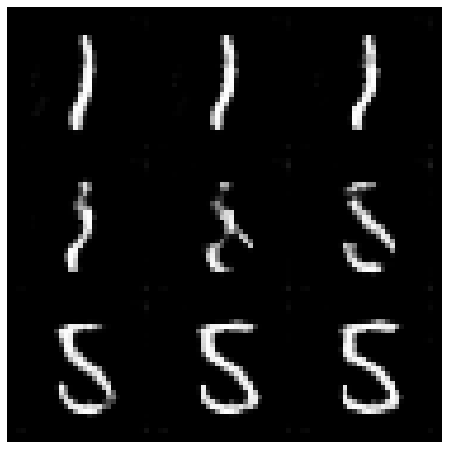

In [23]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

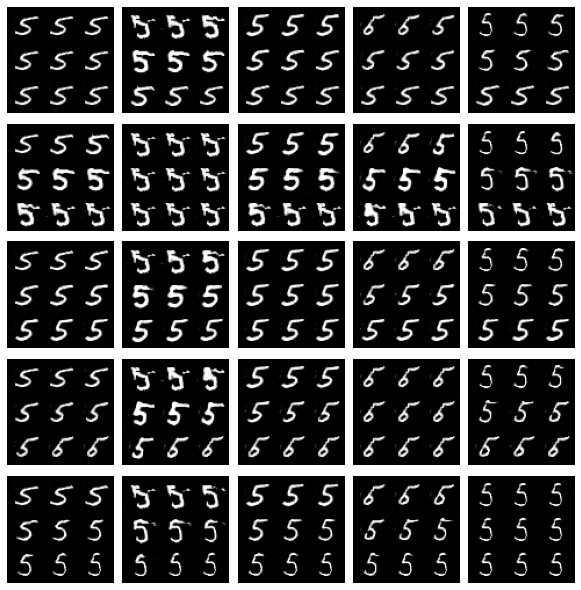

In [24]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()